In [1]:
import osmnx as ox
import geopandas as gpd
import os
from shapely.geometry import LineString
import json
import pandas as pd
from shapely.geometry import shape
from shapely.ops import nearest_points
import pyproj
import matplotlib.pyplot as plt
from pysal.lib import weights
from pysal.explore import esda
import numpy as np
from pyrosm import OSM
from pyrosm import get_data
import pandas_geojson as pdg
from tqdm import tqdm
import time
import seaborn as sns
import folium
from shapely.geometry import Point
import pygris
from branca.element import Element
from matplotlib.patches import Patch
from folium.plugins import MarkerCluster

C:\Users\86158\anaconda3\envs\gds_py\lib\site-packages\numba\core\decorators.py:262: NumbaDeprecationWarning: numba.generated_jit is deprecated. Please see the documentation at: https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-generated-jit for more information and advice on a suitable replacement.
  warnings.warn(msg, NumbaDeprecationWarning)
C:\Users\86158\anaconda3\envs\gds_py\lib\site-packages\quantecon\lss.py:20: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def simulate_linear_model(A, x0, v, ts_length):
C:\Users\86158\anaconda3\envs\gds_py\lib\site-packages\spaghetti\network.py:40: FutureWarning: The next major release of pysal/spaghet

# OSM

If for well known spaces such as New York City, you could access directly by the following codes.

In [6]:
directory = "my_data"
if not os.path.exists(directory):
    os.makedirs(directory)

In [7]:
# Download the data into specified directory
fp = get_data("newyorkcity", directory="my_data")
print("Data was downloaded to:", fp)


Downloaded Protobuf data 'newyorkcity.osm.pbf' (102.91 MB) to:
'C:\Users\86158\civil\spatial merging-5.19\test\my_data\newyorkcity.osm.pbf'
Data was downloaded to: C:\Users\86158\civil\spatial merging-5.19\test\my_data\newyorkcity.osm.pbf


For other areas, you need to geocode.

In [2]:
place_name = "Ithaca,Tompkins,NY, USA"
area = ox.geocode_to_gdf(place_name)

In [3]:
area

,geometry,bbox_north,bbox_south,bbox_east,bbox_west,place_id,osm_type,osm_id,lat,lon,class,type,place_rank,importance,addresstype,name,display_name
0,"POLYGON ((-76.52700 42.45671, -76.52691 42.454...",42.466938,42.418167,-76.469989,-76.527003,9474702,relation,174979,42.439604,-76.496802,boundary,administrative,14,0.545901,city,City of Ithaca,"City of Ithaca, Tompkins County, New York, Uni..."


<Axes: >

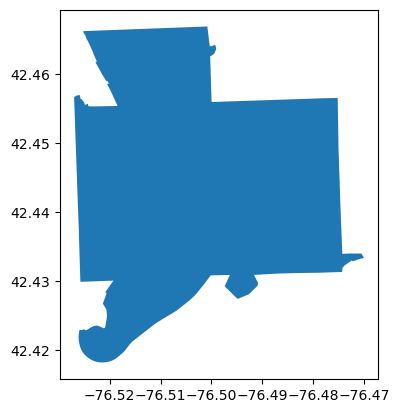

In [9]:
area.plot()

## PBF Manipulation

### Drivenets from OSM

If you have your pbf downloaded, you could you the following code, if not, please refer to the next part

<Axes: >

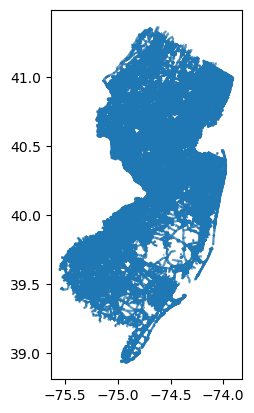

In [3]:
path=r"nj.pbf" 
nj_road = OSM(path)
nj_drive_net = nj_road.get_network(network_type="driving")
nj_drive_net.plot()

In [ ]:
path=r"newyorkcity.osm.pbf" 
ny_road = OSM(path)
ny_drive_net = ny_road.get_network(network_type="driving")

### Buildings from OSM

In [ ]:
fp = get_data("nj.pbf")
# Initialize the OSM parser object
osm = OSM(fp)
nj_buildings = osm.get_buildings()


In [ ]:
fp = get_data("ny.pbf")
# Initialize the OSM parser object
osm = OSM(fp)
ny_buildings = osm.get_buildings()


### POIs from OSM

In [ ]:
fp = get_data("nj.pbf")
# Initialize the OSM parser object
osm = OSM(fp)

# By default pyrosm reads all elements having "amenity", "shop" or "tourism" tag
# Here, let's read only "amenity" and "shop" by applying a custom filter that
# overrides the default filtering mechanism
custom_filter = {'amenity': True, "shop": True}
pois = osm.get_pois(custom_filter=custom_filter)

# Gather info about POI type (combines the tag info from "amenity" and "shop")
pois["poi_type"] = pois["amenity"]
pois["poi_type"] = pois["poi_type"].fillna(pois["shop"])

# Plot
ax = pois.plot(column='poi_type', markersize=3, figsize=(12,12), legend=True, legend_kwds=dict(loc='upper left', ncol=5, bbox_to_anchor=(1, 1)))

In [ ]:
fp = get_data("ny.pbf")
# Initialize the OSM parser object
osm = OSM(fp)

# By default pyrosm reads all elements having "amenity", "shop" or "tourism" tag
# Here, let's read only "amenity" and "shop" by applying a custom filter that
# overrides the default filtering mechanism
custom_filter = {'amenity': True, "shop": True}
pois = osm.get_pois(custom_filter=custom_filter)

# Gather info about POI type (combines the tag info from "amenity" and "shop")
pois["poi_type"] = pois["amenity"]
pois["poi_type"] = pois["poi_type"].fillna(pois["shop"])

# Plot
ax = pois.plot(column='poi_type', markersize=3, figsize=(12,12), legend=True, legend_kwds=dict(loc='upper left', ncol=5, bbox_to_anchor=(1, 1)))

### Land Use from OSM

In [ ]:
fp = get_data("nj.pbf")
# Initialize the OSM parser object
osm = OSM(fp)
landuse = osm.get_landuse()

In [ ]:
fp = get_data("ny.pbf")
# Initialize the OSM parser object
osm = OSM(fp)
landuse = osm.get_landuse()

## Retrieve feactures from with OSMnx

In OpenStreetMap (OSM) data, Tags are key value pairs used to describe the properties and metadata of various objects on a map, such as roads, buildings, rivers, etc. These tags provide detailed information about geographic entities, such as their names, types, materials, usage status, etc. Here are some common examples of OSM tags: 

Amenity: used to represent facilities on a map, such as amenity=school, Amenity=hospital, Amenity=parking. 

Highway: used to identify various types of roads, such as highway=motorway, Highway=residential. 

Building: Used to identify the type of building, such as building=house, Building=commercial. 

Natural: Used to identify natural features, such as natural=water (water body), Natural=tree. 

Land: used to indicate the type of land use, such as land=residential, Land use=forest.

### OSM buildings

In [4]:
# List key-value pairs for tags
tags = {'building': True}   

buildings = ox.geometries_from_place(place_name, tags)
buildings.head()

C:\Users\86158\AppData\Local\Temp\ipykernel_30952\2857596332.py:4: UserWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.
  buildings = ox.geometries_from_place(place_name, tags)


geometry           amenity  \
element_type osmid                                                     
node         368044272  POINT (-76.50111 42.43639)               NaN   
             368045201  POINT (-76.48897 42.44900)               NaN   
             368057074  POINT (-76.50361 42.43750)  community_centre   
             368057082  POINT (-76.49917 42.45528)               NaN   
             368059039  POINT (-76.48780 42.44750)               NaN   

                       denomination  ele gnis:feature_id  \
element_type osmid                                         
node         368044272          NaN  122         2370086   
             368045201          NaN  206         2433649   
             368057074          NaN  121         2370083   
             368057082          NaN  118         2370119   
             368059039          NaN  213         2433641   

                                                              name religion  \
element_type osmid                                                            
node         368044272  Tompkins County Chapter American Red Cross      NaN   
             368045201                                 Boldt Tower      NaN   
             368057074                  Southside Community Center      NaN   
             368057082                          Claude L Kulp Hall      NaN   
             368059039                           War Memorial Hall      NaN   

                       addr:state building         source  ... shelter_type  \
element_type osmid                                         ...                
node         368044272         NY      yes  USGS Geonames  ...          NaN   
             368045201         NY      yes  USGS Geonames  ...          NaN   
             368057074         NY      yes  USGS Geonames  ...          NaN   
             368057082         NY      yes  USGS Geonames  ...          NaN   
             368059039         NY      yes  USGS Geonames  ...          NaN   

                        lit museum landuse residential content fast_food  \
element_type osmid                                                         
node         368044272  NaN    NaN     NaN         NaN     NaN       NaN   
             368045201  NaN    NaN     NaN         NaN     NaN       NaN   
             368057074  NaN    NaN     NaN         NaN     NaN       NaN   
             368057082  NaN    NaN     NaN         NaN     NaN       NaN   
             368059039  NaN    NaN     NaN         NaN     NaN       NaN   

                       indoor_seating ways type  
element_type osmid                               
node         368044272            NaN  NaN  NaN  
             368045201            NaN  NaN  NaN  
             368057074            NaN  NaN  NaN  
             368057082            NaN  NaN  NaN  
             368059039            NaN  NaN  NaN  

[5 rows x 173 columns]

<Axes: >

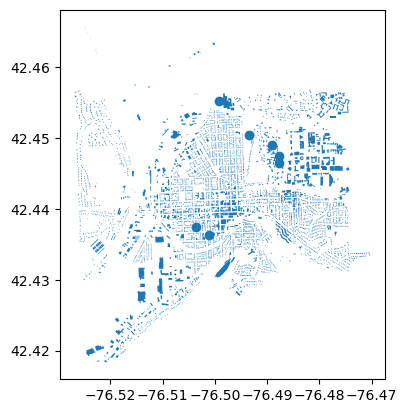

In [13]:
buildings.plot()

### OSM Amentities (Places)

In [5]:
# List key-value pairs for tags
tags = {'amenity': True}   

places = ox.geometries_from_place(place_name, tags)
places.head()

C:\Users\86158\AppData\Local\Temp\ipykernel_30952\4209894165.py:4: UserWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.
  places = ox.geometries_from_place(place_name, tags)


amenity  ele gnis:feature_id  \
element_type osmid                                              
node         357559160            school  122          949880   
             357633590  place_of_worship  119         2370071   
             357633598  place_of_worship  120         2370074   
             357633605            school  121         2370076   
             357633608            school  121         2370077   

                                                           name  \
element_type osmid                                                
node         357559160                        Fall Creek School   
             357633590                         Church of Christ   
             357633598                   Calvary Baptist Church   
             357633605  Greater Ithaca Activities Center (GIAC)   
             357633608      Beverly J. Martin Elementary School   

                                          geometry   religion denomination  \
element_type osmid                                                           
node         357559160  POINT (-76.49550 42.45091)        NaN          NaN   
             357633590  POINT (-76.50028 42.45333)  christian          NaN   
             357633598  POINT (-76.50167 42.44389)  christian      baptist   
             357633605  POINT (-76.50222 42.44222)        NaN          NaN   
             357633608  POINT (-76.50222 42.44139)        NaN          NaN   

                       wheelchair  check_date service_times  ...  lit  \
element_type osmid                                           ...        
node         357559160        NaN         NaN           NaN  ...  NaN   
             357633590        NaN         NaN           NaN  ...  NaN   
             357633598        NaN         NaN           NaN  ...  NaN   
             357633605        yes         NaN           NaN  ...  NaN   
             357633608        yes  2024-04-09           NaN  ...  NaN   

                       building:part heating area fast_food location grades  \
element_type osmid                                                            
node         357559160           NaN     NaN  NaN       NaN      NaN    NaN   
             357633590           NaN     NaN  NaN       NaN      NaN    NaN   
             357633598           NaN     NaN  NaN       NaN      NaN    NaN   
             357633605           NaN     NaN  NaN       NaN      NaN    NaN   
             357633608           NaN     NaN  NaN       NaN      NaN    NaN   

                       ways type note  
element_type osmid                     
node         357559160  NaN  NaN  NaN  
             357633590  NaN  NaN  NaN  
             357633598  NaN  NaN  NaN  
             357633605  NaN  NaN  NaN  
             357633608  NaN  NaN  NaN  

[5 rows x 179 columns]

#### Way to save as geojson

In [ ]:


# Check and process columns containing list type data
for col in osm_places.columns:
    if osm_places[col].apply(lambda x: isinstance(x, list)).any():
        osm_places[col] = osm_places[col].apply(lambda x: x[0] if isinstance(x, list) and len(x) > 0 else None)

# Ensure the GeoDataFrame contains a valid geometry column
if 'geometry' not in osm_places.columns:
    # Here we assume 'longitude' and 'latitude' are your coordinate columns
    osm_places = gpd.GeoDataFrame(osm_places, geometry=gpd.points_from_xy(osm_places.longitude, osm_places.latitude))

# Print the first few rows of the DataFrame to check the new columns
print(osm_places.head())

# Save the DataFrame as a GeoJSON file
osm_places.to_file('osm_places.geojson', driver='GeoJSON')


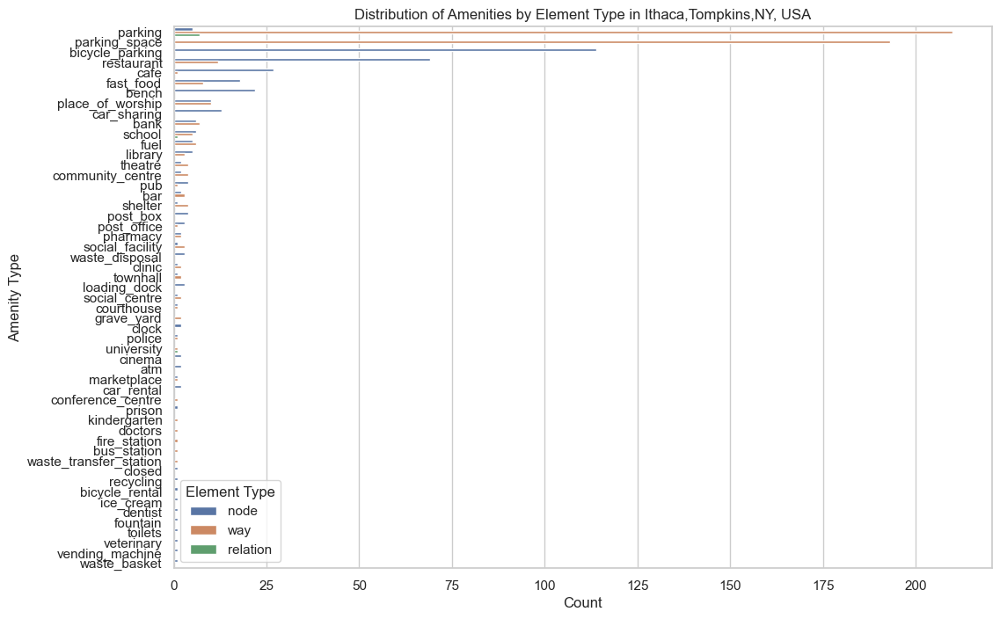

In [20]:

sns.set(style="whitegrid")
plt.figure(figsize=(12, 8))
sns.countplot(data=places, y='amenity', hue='element_type', order=places['amenity'].value_counts().index)
plt.title('Distribution of Amenities by Element Type in ' + place_name)
plt.xlabel('Count')
plt.ylabel('Amenity Type')
plt.legend(title='Element Type')
plt.show()

#### Use Folium to visualize the places

In [4]:

# Initialize the map:
m = folium.Map(location=[42.45091, -76.49550], zoom_start=13)  # Centered based on your data's approximate coordinates

# Define colors for different amenities
amenity_colors = {
    'school': 'blue',
    'place_of_worship': 'green',
    'hospital': 'red',  # Add more as needed
    'parking': 'purple',  # Add more as needed
    'default': 'gray'   # For any other types not listed above
}

# Function to choose colors
def get_color(amenity):
    return amenity_colors.get(amenity, amenity_colors['default'])

# Add markers to the map
for index, row in places.iterrows():
    # Extract coordinates directly from the Point object
    if isinstance(row['geometry'], Point):
        lat = row['geometry'].y
        lon = row['geometry'].x

        # Create marker
        folium.Marker(
            [lat, lon],
            popup=f"{row['amenity']}: {row.get('name', 'No Name')}",
            icon=folium.Icon(color=get_color(row['amenity']))
        ).add_to(m)

# Show the map
m


### OSM Road (Highway)

In [88]:
# List key-value pairs for tags
tags = {'highway': True}   

roads = ox.geometries_from_place(place_name, tags)
roads.head()

C:\Users\86158\AppData\Local\Temp\ipykernel_30952\1537713104.py:4: UserWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.
  roads = ox.geometries_from_place(place_name, tags)


crossing   highway                    geometry stop  \
element_type osmid                                                           
node         213409451   marked  crossing  POINT (-76.51854 42.44882)  NaN   
             213409896      NaN      stop  POINT (-76.50126 42.44688)  all   
             213409899      NaN      stop  POINT (-76.50200 42.44781)  all   
             213410347      NaN      stop  POINT (-76.50365 42.43385)  NaN   
             213410357      NaN      stop  POINT (-76.50367 42.43428)  NaN   

                       access barrier source direction crossing:island  \
element_type osmid                                                       
node         213409451    NaN     NaN    NaN       NaN             NaN   
             213409896    NaN     NaN    NaN       NaN             NaN   
             213409899    NaN     NaN    NaN       NaN             NaN   
             213410347    NaN     NaN    NaN       NaN             NaN   
             213410357    NaN     NaN    NaN       NaN             NaN   

                       crossing:signals  ... cycleway:left:lane area wikidata  \
element_type osmid                       ...                                    
node         213409451              NaN  ...                NaN  NaN      NaN   
             213409896              NaN  ...                NaN  NaN      NaN   
             213409899              NaN  ...                NaN  NaN      NaN   
             213410347              NaN  ...                NaN  NaN      NaN   
             213410357              NaN  ...                NaN  NaN      NaN   

                       wikipedia informal tracktype ramp:wheelchair  \
element_type osmid                                                    
node         213409451       NaN      NaN       NaN             NaN   
             213409896       NaN      NaN       NaN             NaN   
             213409899       NaN      NaN       NaN             NaN   
             213410347       NaN      NaN       NaN             NaN   
             213410357       NaN      NaN       NaN             NaN   

                       unsigned_ref ways type  
element_type osmid                             
node         213409451          NaN  NaN  NaN  
             213409896          NaN  NaN  NaN  
             213409899          NaN  NaN  NaN  
             213410347          NaN  NaN  NaN  
             213410357          NaN  NaN  NaN  

[5 rows x 167 columns]

In [45]:
roads

crossing   highway  \
element_type osmid                           
node         213409451    marked  crossing   
             213409896       NaN      stop   
             213409899       NaN      stop   
             213410347       NaN      stop   
             213410357       NaN      stop   
...                          ...       ...   
way          1252512921      NaN   footway   
             1252512922      NaN   footway   
             1252512923      NaN   footway   
             1271200421      NaN   primary   
relation     4614658         NaN   service   

                                                                  geometry  \
element_type osmid                                                           
node         213409451                          POINT (-76.51854 42.44882)   
             213409896                          POINT (-76.50126 42.44688)   
             213409899                          POINT (-76.50200 42.44781)   
             213410347                          POINT (-76.50365 42.43385)   
             213410357                          POINT (-76.50367 42.43428)   
...                                                                    ...   
way          1252512921  LINESTRING (-76.49449 42.44285, -76.49444 42.4...   
             1252512922  LINESTRING (-76.48414 42.44342, -76.48415 42.4...   
             1252512923  LINESTRING (-76.48031 42.44272, -76.48047 42.4...   
             1271200421  LINESTRING (-76.51971 42.45785, -76.51986 42.4...   
relation     4614658     POLYGON ((-76.49955 42.43850, -76.49926 42.438...   

                        stop access barrier source direction crossing:island  \
element_type osmid                                                             
node         213409451   NaN    NaN     NaN    NaN       NaN             NaN   
             213409896   all    NaN     NaN    NaN       NaN             NaN   
             213409899   all    NaN     NaN    NaN       NaN             NaN   
             213410347   NaN    NaN     NaN    NaN       NaN             NaN   
             213410357   NaN    NaN     NaN    NaN       NaN             NaN   
...                      ...    ...     ...    ...       ...             ...   
way          1252512921  NaN    NaN     NaN    NaN       NaN             NaN   
             1252512922  NaN    NaN     NaN    NaN       NaN             NaN   
             1252512923  NaN    NaN     NaN    NaN       NaN             NaN   
             1271200421  NaN    NaN     NaN    NaN       NaN             NaN   
relation     4614658     NaN    NaN     NaN    NaN       NaN             NaN   

                        crossing:signals  ... cycleway:left:lane area  \
element_type osmid                        ...                           
node         213409451               NaN  ...                NaN  NaN   
             213409896               NaN  ...                NaN  NaN   
             213409899               NaN  ...                NaN  NaN   
             213410347               NaN  ...                NaN  NaN   
             213410357               NaN  ...                NaN  NaN   
...                                  ...  ...                ...  ...   
way          1252512921              NaN  ...                NaN  NaN   
             1252512922              NaN  ...                NaN  NaN   
             1252512923              NaN  ...                NaN  NaN   
             1271200421              NaN  ...                NaN  NaN   
relation     4614658                 NaN  ...                NaN  yes   

                        wikidata wikipedia informal tracktype ramp:wheelchair  \
element_type osmid                                                              
node         213409451       NaN       NaN      NaN       NaN             NaN   
             213409896       NaN       NaN      NaN       NaN             NaN   
             213409899       NaN       NaN      NaN       NaN             NaN   
             2

In [11]:
# Initialize the map, here directly with an example center point of Ithaca
m = folium.Map(location=[42.45091, -76.49550], zoom_start=13)

# Function to determine the color of the road based on its 'highway' type
def get_color(highway_type):
    colors = {
        'motorway': 'red',
        'primary': 'blue',
        'secondary': 'green',
        'tertiary': 'purple',
        'residential': 'orange',
        'footway': 'brown',
        'service': 'gray',
        'path': 'black',
        'default': 'black'
    }
    return colors.get(highway_type, colors['default'])

# Add each road to the map
for idx, road in roads.iterrows():
    # Ensure the road geometry is a LineString or MultiLineString
    if road.geometry.geom_type in ['LineString', 'MultiLineString']:
        folium.PolyLine(
            locations=[(point[1], point[0]) for point in road.geometry.coords],
            color=get_color(road['highway']),
            weight=3,
            opacity=0.8
        ).add_to(m)

# Display the map
m

In [23]:
import folium
from branca.element import Element

# Initialize the map, here directly with an example center point of Ithaca
m = folium.Map(location=[42.45091, -76.49550], zoom_start=13)

# Function to determine the color of the road based on its 'highway' type
def get_color(highway_type):
    colors = {
        'motorway': 'red',
        'primary': 'blue',
        'secondary': 'green',
        'tertiary': 'purple',
        'residential': 'orange',
        'footway': 'brown',
        'service': 'gray',
        'path': 'black',
        'default': 'black'
    }
    return colors.get(highway_type, colors['default'])

# Add each road to the map
for idx, road in roads.iterrows():
    if road.geometry.geom_type in ['LineString', 'MultiLineString']:
        folium.PolyLine(
            locations=[(point[1], point[0]) for point in road.geometry.coords],
            color=get_color(road['highway']),
            weight=3,
            opacity=0.8
        ).add_to(m)

# Create a more visually appealing legend as HTML
legend_html = '''
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 200px; height: 240px; 
            background-color: rgba(255,255,255,0.8); border-radius: 8px;
            box-shadow: 2px 2px 5px #888888; z-index:9999; font-size:14px;
            padding: 10px;">

            &nbsp; <strong>Road Types</strong> <br><hr>
            &nbsp; Motorway &nbsp; <i style="background:red">&nbsp;&nbsp;&nbsp;&nbsp;</i><br>
            &nbsp; Primary &nbsp; <i style="background:blue">&nbsp;&nbsp;&nbsp;&nbsp;</i><br>
            &nbsp; Secondary &nbsp; <i style="background:green">&nbsp;&nbsp;&nbsp;&nbsp;</i><br>
            &nbsp; Tertiary &nbsp; <i style="background:purple">&nbsp;&nbsp;&nbsp;&nbsp;</i><br>
            &nbsp; Residential &nbsp; <i style="background:orange">&nbsp;&nbsp;&nbsp;&nbsp;</i><br>
            &nbsp; Footway &nbsp; <i style="background:brown">&nbsp;&nbsp;&nbsp;&nbsp;</i><br>
            &nbsp; Service &nbsp; <i style="background:gray">&nbsp;&nbsp;&nbsp;&nbsp;</i><br>
            &nbsp; Path &nbsp; <i style="background:black">&nbsp;&nbsp;&nbsp;&nbsp;</i><br>
            </div>
'''
# Attach the legend to the map
legend = Element(legend_html)
m.get_root().html.add_child(legend)

# Export the map to an HTML file
m.save('ithaca_roads_map.html')

# To show the map in Jupyter or other environments that support inline display
m


### OSM Land Use

In [17]:
# List key-value pairs for tags
tags = {'landuse': True}   

landuse = ox.geometries_from_place(place_name, tags)
landuse.head()

C:\Users\86158\AppData\Local\Temp\ipykernel_34272\1948618180.py:4: UserWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.
  landuse = ox.geometries_from_place(place_name, tags)


geometry  \
element_type osmid                                                           
node         6431662419                         POINT (-76.49508 42.43933)   
way          108626312   POLYGON ((-76.49023 42.44616, -76.49275 42.446...   
             108629419   POLYGON ((-76.48228 42.43499, -76.48153 42.435...   
             205387288   POLYGON ((-76.50049 42.46265, -76.50052 42.462...   
             311207406   POLYGON ((-76.48465 42.45078, -76.48383 42.450...   

                        addr:city addr:housenumber addr:postcode addr:state  \
element_type osmid                                                            
node         6431662419    Ithaca              301         14850         NY   
way          108626312        NaN              NaN           NaN        NaN   
             108629419        NaN              NaN           NaN        NaN   
             205387288        NaN              NaN           NaN        NaN   
             311207406        NaN              NaN           NaN        NaN   

                               addr:street      landuse  \
element_type osmid                                        
node         6431662419  East State Street  residential   
way          108626312                 NaN     cemetery   
             108629419                 NaN     cemetery   
             205387288                 NaN        grass   
             311207406                 NaN        grass   

                                          name residential  \
element_type osmid                                           
node         6431662419     City Centre Ithaca  apartments   
way          108626312    Ithaca City Cemetery         NaN   
             108629419   Mount Olivet Cemetery         NaN   
             205387288                     NaN         NaN   
             311207406               Arts Quad         NaN   

                                                                     nodes  \
element_type osmid                                                           
node         6431662419                                                NaN   
way          108626312   [1245772916, 10102189771, 10102189776, 1010218...   
             108629419   [1245803709, 1245803731, 1245803726, 124580371...   
             205387288   [2153581803, 2153581797, 2153581794, 215358179...   
             311207406   [1043464237, 1043464414, 1043464523, 104346445...   

                         ... golf operator image website plant:method  \
element_type osmid       ...                                            
node         6431662419  ...  NaN      NaN   NaN     NaN          NaN   
way          108626312   ...  NaN      NaN   NaN     NaN          NaN   
             108629419   ...  NaN      NaN   NaN     NaN          NaN   
             205387288   ...  NaN      NaN   NaN     NaN          NaN   
             311207406   ...  NaN      NaN   NaN     NaN          NaN   

                        plant:output:electricity plant:output:hot_water  \
element_type osmid                                                        
node         6431662419                      NaN                    NaN   
way          108626312                       NaN                    NaN   
             108629419                       NaN                    NaN   
             205387288                       NaN                    NaN   
             311207406                       NaN                    NaN   

                        plant:source ref:US:EIA start_date  
element_type osmid                                          
node         6431662419          NaN        NaN        NaN  
way          108626312           NaN        NaN        NaN  
             108629419           NaN        NaN        NaN  
             205387288           NaN        NaN        NaN  
             311207406           NaN        NaN        NaN  

[5 rows x 32 columns]

In [34]:

m = folium.Map(location=[42.45091, -76.49550], zoom_start=13)

# Function to apply styles
def style_function(feature):
    return {
        'fillColor': '#ffff00',  # Default yellow
        'color': 'black',        # Outline color
        'weight': 2,
        'fillOpacity': 0.5
    }

# Add geometries to the map
for idx, item in landuse.iterrows():
    geom_type = item.geometry.geom_type
    if geom_type in ['Polygon', 'MultiPolygon']:
        folium.GeoJson(
            data={
                "type": "Feature",
                "properties": {},  # Include other properties here if needed
                "geometry": item.geometry.__geo_interface__
            },
            style_function=style_function,
            tooltip=f"Name: {item.get('name', 'N/A')}"
        ).add_to(m)
    elif geom_type == 'Point':
        folium.CircleMarker(
            location=[item.geometry.y, item.geometry.x],
            radius=5,
            color='blue',
            fill=True,
            fill_color='blue',
            fill_opacity=0.7,
            tooltip=f"Name: {item.get('name', 'N/A')}"
        ).add_to(m)

# Save or display the map
m.save('ithaca_landuse_map.html')
m


### OSM Natural

In [18]:
# List key-value pairs for tags
tags = {'natural': True}   

natural = ox.geometries_from_place(place_name, tags)
natural.head()

C:\Users\86158\AppData\Local\Temp\ipykernel_34272\1949204819.py:4: UserWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.
  natural = ox.geometries_from_place(place_name, tags)


name seamark:type                    geometry leisure  \
element_type osmid                                                              
node         9007310929  NaN          NaN  POINT (-76.49067 42.45046)     NaN   
             9007310930  NaN          NaN  POINT (-76.49063 42.45040)     NaN   
             9007310931  NaN          NaN  POINT (-76.49074 42.45087)     NaN   
             9007310932  NaN          NaN  POINT (-76.49077 42.45086)     NaN   
             9342335739  NaN          NaN  POINT (-76.48782 42.44933)     NaN   

                        source denotation   diameter      genus leaf_cycle  \
element_type osmid                                                           
node         9007310929    NaN     single  14 inches  Ailanthus  deciduous   
             9007310930    NaN    cluster        NaN        NaN        NaN   
             9007310931    NaN     single       4 in        NaN        NaN   
             9007310932    NaN    cluster        NaN        NaN        NaN   
             9342335739    NaN        NaN        NaN        NaN        NaN   

                           leaf_type  ... seamark:harbour:category golf ways  \
element_type osmid                    ...                                      
node         9007310929  broadleaved  ...                      NaN  NaN  NaN   
             9007310930          NaN  ...                      NaN  NaN  NaN   
             9007310931          NaN  ...                      NaN  NaN  NaN   
             9007310932          NaN  ...                      NaN  NaN  NaN   
             9342335739          NaN  ...                      NaN  NaN  NaN   

                        intermittent name:moh type wikidata wikipedia salt  \
element_type osmid                                                           
node         9007310929          NaN      NaN  NaN      NaN       NaN  NaN   
             9007310930          NaN      NaN  NaN      NaN       NaN  NaN   
             9007310931          NaN      NaN  NaN      NaN       NaN  NaN   
             9007310932          NaN      NaN  NaN      NaN       NaN  NaN   
             9342335739          NaN      NaN  NaN      NaN       NaN  NaN   

                        wikimedia_commons  
element_type osmid                         
node         9007310929               NaN  
             9007310930               NaN  
             9007310931               NaN  
             9007310932               NaN  
             9342335739               NaN  

[5 rows x 28 columns]

In [41]:

# Assuming 'natural' is your GeoDataFrame containing the natural features with a 'geometry' column
# Initialize the map centered on Ithaca
m = folium.Map(location=[42.45091, -76.49550], zoom_start=13)

# Function to apply styles for natural features based on their type
def style_natural(feature):
    # Example: style differently if 'leisure' is park
    if feature['properties'].get('leisure') == 'park':
        return {'color': 'green', 'fillColor': '#64b947', 'weight': 1.5, 'fillOpacity': 0.5}
    else:
        return {'color': 'gray', 'fillColor': '#b9b9b9', 'weight': 1, 'fillOpacity': 0.3}

# Function to determine tooltip content
def get_tooltip(properties):
    # Display name and type if available
    name = properties.get('name', 'Unknown')
    typ = properties.get('seamark:type', 'N/A')
    return f"{name} ({typ})"

# Add natural features to the map
for idx, feature in natural.iterrows():
    geom_type = feature.geometry.geom_type
    properties = {
        'name': feature.get('name', 'N/A'),
        'seamark:type': feature.get('seamark:type', 'N/A'),
        # add other properties here as needed
    }
    geo_json_data = {
        "type": "Feature",
        "properties": properties,
        "geometry": feature.geometry.__geo_interface__
    }
    
    if geom_type in ['Polygon', 'MultiPolygon']:
        folium.GeoJson(
            data=geo_json_data,
            style_function=style_natural,
            tooltip=get_tooltip(properties)
        ).add_to(m)
    elif geom_type in ['LineString', 'MultiLineString']:
        folium.GeoJson(
            data=geo_json_data,
            style_function=lambda x: {'color': 'blue', 'weight': 2},
            tooltip=get_tooltip(properties)
        ).add_to(m)
    elif geom_type == 'Point':
        folium.CircleMarker(
            location=[feature.geometry.y, feature.geometry.x],
            radius=5,
            color='blue',
            fill=True,
            fill_color='blue',
            fill_opacity=0.7,
            tooltip=get_tooltip(properties)
        ).add_to(m)

# Save or display the map
m.save('ithaca_natural_map.html')
m


# Tiger/Line

## Road from Tiger/Line

Using the default year of 2021
Using FIPS code '36' for input 'NY'
Using FIPS code '109' for input 'Tompkins'


<Axes: >

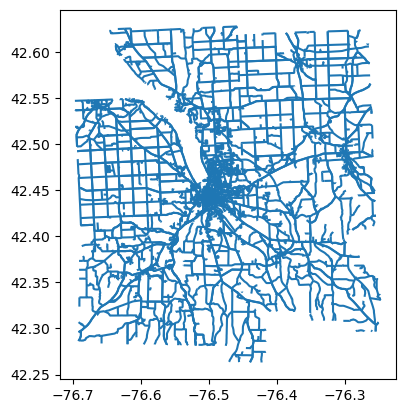

In [96]:
tiger = pygris.roads(state = "NY", county = "Tompkins")
tiger.plot()

In [97]:
tiger

,LINEARID,FULLNAME,RTTYP,MTFCC,geometry
0,110763943980,Hudson St Exd,M,S1400,"LINESTRING (-76.49174 42.43033, -76.49188 42.4..."
1,1103571241946,Gussie St Exd,M,S1400,"LINESTRING (-76.51326 42.43239, -76.51334 42.4..."
2,1104755804697,Milliken Station Rd Exd,M,S1400,"LINESTRING (-76.63350 42.59730, -76.63358 42.5..."
3,1104755804698,Milliken Station Rd Exd,M,S1400,"LINESTRING (-76.63298 42.59660, -76.63300 42.5..."
4,110763942416,Elm St Exd,M,S1400,"LINESTRING (-76.55375 42.43542, -76.55366 42.4..."
...,...,...,...,...,...
2983,110763943416,Ploss Ln,M,S1400,"LINESTRING (-76.65877 42.53232, -76.65853 42.5..."
2984,110763947098,Taughannock Park Rd,M,S1400,"LINESTRING (-76.60675 42.54580, -76.60478 42.5..."
2985,110763963345,None,None,S1400,"LINESTRING (-76.59619 42.54504, -76.59615 42.5..."
2986,110763963692,None,None,S1740,"LINESTRING (-76.56747 42.52978, -76.56806 42.5..."


In [98]:

ithaca_boundary = gpd.read_file("IthacaOverture/Ithaca_Boundary.geojson")

ithaca_boundary = ithaca_boundary.to_crs(tiger.crs)

# Clip the roads data using the Ithaca boundary
# This creates new geometries clipped to the boundary polygon
ithaca_tiger = gpd.clip(tiger, ithaca_boundary)


In [99]:
ithaca_tiger

,LINEARID,FULLNAME,RTTYP,MTFCC,geometry
920,1104697442958,Co Rd 119,C,S1400,"LINESTRING (-76.49127 42.42917, -76.49151 42.4..."
1308,1104697443664,Coddington Rd,M,S1400,"LINESTRING (-76.49127 42.42917, -76.49151 42.4..."
1667,110763942392,State Rte 96B,S,S1200,"LINESTRING (-76.49640 42.43095, -76.49637 42.4..."
111,1103690227442,S Hill Recreation Way,M,S1400,"LINESTRING (-76.49126 42.42921, -76.49123 42.4..."
2821,110763963163,None,None,S1400,"LINESTRING (-76.47954 42.43125, -76.47957 42.4..."
...,...,...,...,...,...
374,110763946613,Trumansburg Rd,M,S1200,"LINESTRING (-76.52151 42.45450, -76.52191 42.4..."
373,1106087299824,Taughannock Blvd,M,S1200,"LINESTRING (-76.52043 42.45863, -76.52038 42.4..."
717,110763963356,None,None,S1400,"LINESTRING (-76.51495 42.45625, -76.51470 42.4..."
700,110763963756,None,None,S1740,"LINESTRING (-76.51278 42.45858, -76.51254 42.4..."


In [21]:
# Initialize a folium map centered around Ithaca
m = folium.Map(location=[42.443961, -76.501881], zoom_start=13, tiles='cartodbpositron')

def add_roads_to_map(df, map_obj):
    for _, row in df.iterrows():
        geom = row['geometry']
        # Check the type of geometry
        if geom.geom_type == 'LineString':
            line_points = [(point[1], point[0]) for point in geom.coords]
            folium.PolyLine(line_points, color='blue', weight=2, opacity=0.7, tooltip=row['FULLNAME']).add_to(map_obj)
        elif geom.geom_type == 'MultiLineString':
            for line in geom.geoms:  # Correct way to iterate over each LineString in a MultiLineString
                line_points = [(point[1], point[0]) for point in line.coords]
                folium.PolyLine(line_points, color='blue', weight=2, opacity=0.7, tooltip=row['FULLNAME']).add_to(map_obj)

# Add roads to the map
add_roads_to_map(ithaca_tiger, m)

# Display the map
m

# Overture

### Overture Building 

In [2]:
def read_geojson_with_progress(path):
    # Read the GeoJSON file with progress
    data = ""
    with open(path, "r") as file:
        for line in tqdm(file, desc="Reading GeoJSON"):
            data += line
    return data

def parse_geojson(geojson_str):
    # Parse the GeoJSON string to JSON
    try:
        return json.loads(geojson_str)
    except json.JSONDecodeError:
        raise ValueError("Failed to decode GeoJSON: the data might be corrupted or improperly formatted.")

# Start the timer
start_time = time.time()

# Load the GeoJSON content with progress bar
geojson_content = read_geojson_with_progress("IthacaOverture/ithaca_building.geojson")

# Parse the JSON content from the string
geojson_data = parse_geojson(geojson_content)

# Convert the JSON data to GeoDataFrame
overture_building = gpd.GeoDataFrame.from_features(geojson_data['features'])  # Ensure the 'features' key exists and is correct

# Stop the timer
end_time = time.time()

# Calculate the duration
duration = end_time - start_time

print("Time taken to load the file:", duration, "seconds")
print(overture_building.head())  # Print just the head to check if it's loaded correctly


Reading GeoJSON: 21420it [00:10, 1964.43it/s]


Time taken to load the file: 14.678250789642334 seconds
                                            geometry  \
0  POLYGON ((-76.58932 42.38976, -76.58923 42.389...   
1  POLYGON ((-76.58914 42.39035, -76.58912 42.390...   
2  POLYGON ((-76.58830 42.38982, -76.58825 42.389...   
3  POLYGON ((-76.58745 42.39041, -76.58743 42.390...   
4  POLYGON ((-76.58686 42.38993, -76.58676 42.390...   

                                 id  version               update_time  \
0  08b2aa4324c52fff02002a2efdec26f0        0  2024-04-06T07:00:00.000Z   
1  08b2aa4324c0bfff02007d07c1989f83        0  2024-04-06T07:00:00.000Z   
2  08b2aa4324c50fff02005faea9b972ae        0  2024-04-06T07:00:00.000Z   
3  08b2aa4324c73fff020030c0687b93a8        0  2024-04-06T07:00:00.000Z   
4  08b2aa4324c46fff0200bd3a8ecfc600        0  2024-04-06T07:00:00.000Z   

                                             sources  has_parts  height names  \
0  [{'property': '', 'dataset': 'Esri Community M...      False     NaN   NaN   


In [15]:
# Apply parse_json to the 'sources' column
overture_building['sources'] = overture_building['sources'].apply(parse_json)

# Flatten the list of dictionaries to a DataFrame
new_cols = pd.DataFrame([item for sublist in overture_building['sources'] for item in sublist])

# Drop the original 'sources' column from overture
overture_building = overture_building.drop(columns=['sources'])

# Join new_cols to overture, using suffixes to resolve column name conflicts
overture_building= overture_building.join(new_cols, lsuffix='_overture', rsuffix='_new')

# Print the updated GeoDataFrame
print(overture_building.head())


                                            geometry  \
0  POLYGON ((-76.58932 42.38976, -76.58923 42.389...   
1  POLYGON ((-76.58914 42.39035, -76.58912 42.390...   
2  POLYGON ((-76.58830 42.38982, -76.58825 42.389...   
3  POLYGON ((-76.58745 42.39041, -76.58743 42.390...   
4  POLYGON ((-76.58686 42.38993, -76.58676 42.390...   

                                 id  version               update_time  \
0  08b2aa4324c52fff02002a2efdec26f0        0  2024-04-06T07:00:00.000Z   
1  08b2aa4324c0bfff02007d07c1989f83        0  2024-04-06T07:00:00.000Z   
2  08b2aa4324c50fff02005faea9b972ae        0  2024-04-06T07:00:00.000Z   
3  08b2aa4324c73fff020030c0687b93a8        0  2024-04-06T07:00:00.000Z   
4  08b2aa4324c46fff0200bd3a8ecfc600        0  2024-04-06T07:00:00.000Z   

   has_parts  height names class  num_floors roof_shape facade_material  \
0      False     NaN   NaN   NaN         NaN        NaN             NaN   
1      False     NaN   NaN   NaN         NaN        NaN             

Drawing datasets: 100%|██████████████████████████████████████████████████████████████████| 3/3 [00:10<00:00,  3.37s/it]


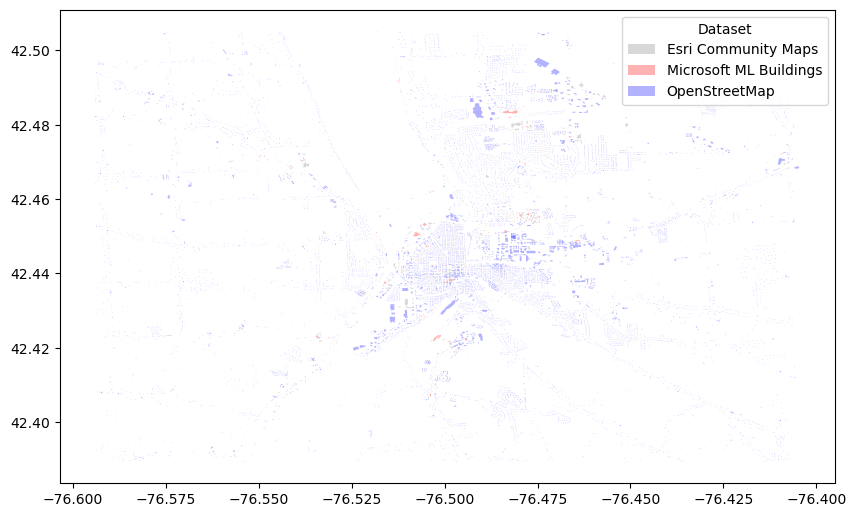

In [19]:

# Create figure and axis objects, set the figure size
fig, ax = plt.subplots(figsize=(10, 10))

# Color settings, specified by dataset name
colors = {
    "Microsoft ML Buildings": "red",  # Red
    "NYC Open Data 3D Buildings": "yellow",  # Yellow
    "OpenStreetMap": "blue"  # Blue
}

# Uniform transparency setting to 0.3
alpha = 0.3

# Prepare a list to store legend information
legend_handles = []

# Plot geographic shapes for each dataset type
for label, df in tqdm(overture_building.groupby('dataset'), desc="Drawing datasets"):
    # Get the color from the color dictionary, use gray as the default if not found
    color = colors.get(label, "gray")
    df.plot(ax=ax, color=color, alpha=alpha)  # Specify color and transparency for plotting

    # Create a legend entry for each dataset
    legend_handles.append(Patch(facecolor=color, edgecolor='none', alpha=alpha, label=label))

# Add the legend
ax.legend(handles=legend_handles, title='Dataset')

# Show the plot
plt.show()


Drawing datasets: 100%|██████████████████████████████████████████████████████████████████| 3/3 [00:10<00:00,  3.58s/it]


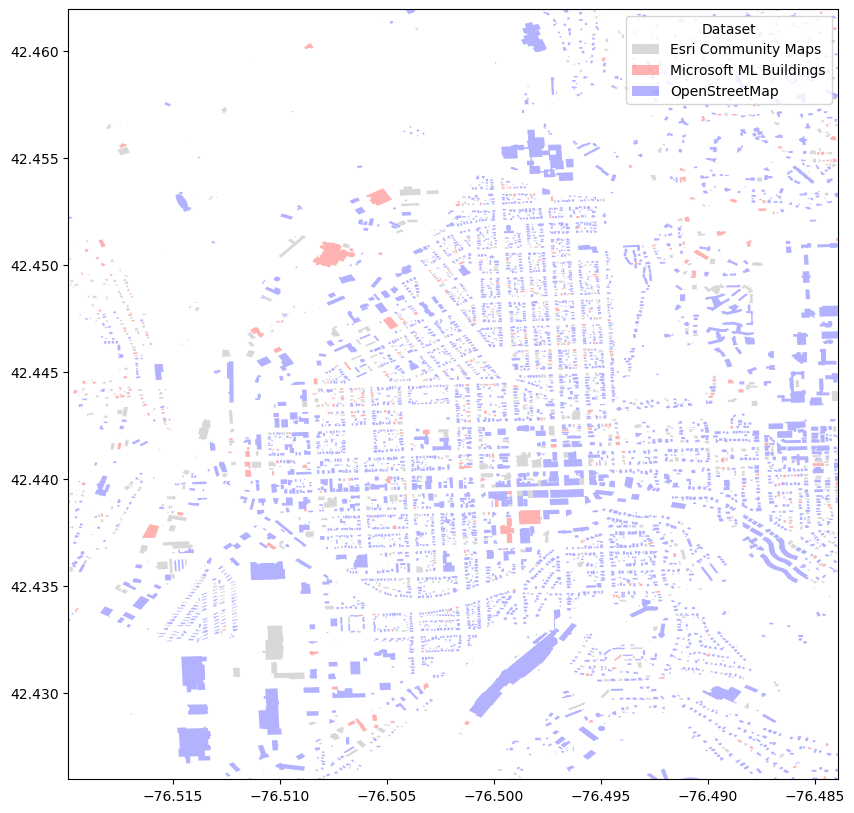

In [22]:
# Approximate latitude and longitude of the center of Ithaca
center_latitude = 42.443961
center_longitude = -76.501881

# Calculate the latitude and longitude increments for a 2 km range
lat_range = 0.018
long_range = 0.018

# Create figure and axis objects, set the figure size
fig, ax = plt.subplots(figsize=(10, 10))

# Set the plot boundaries
ax.set_xlim([center_longitude - long_range, center_longitude + long_range])
ax.set_ylim([center_latitude - lat_range, center_latitude + lat_range])

# Color settings, specified by dataset name
colors = {
    "Microsoft ML Buildings": "red",  # Red
    "NYC Open Data 3D Buildings": "yellow",  # Yellow
    "OpenStreetMap": "blue"  # Blue
}

# Uniform transparency setting
alpha = 0.3

# Prepare a list to store legend information
legend_handles = []

# Plot geographic shapes for each dataset type
for label, df in tqdm(overture_building.groupby('dataset'), desc="Drawing datasets"):
    # Get the color from the color dictionary, use gray as the default if not found
    color = colors.get(label, "gray")
    df.plot(ax=ax, color=color, alpha=alpha)  # Specify color and transparency for plotting

    # Create a legend entry for each dataset
    legend_handles.append(Patch(facecolor=color, edgecolor='none', alpha=alpha, label=label))

# Add the legend
ax.legend(handles=legend_handles, title='Dataset')

# Show the plot
plt.show()

In [24]:

# If your GeoDataFrame doesn't have a CRS, set it to WGS84 (EPSG:4326)
if overture_building.crs is None:
    overture_building = overture_building.set_crs(epsg=4326)

# Approximate latitude and longitude of the center of Ithaca
center_latitude = 42.443961
center_longitude = -76.501881

# Create a Folium map centered at Ithaca
m = folium.Map(location=[center_latitude, center_longitude], zoom_start=14)

# Color settings, specified by dataset name
colors = {
    "Microsoft ML Buildings": "red",  # Red
    "NYC Open Data 3D Buildings": "yellow",  # Yellow
    "OpenStreetMap": "blue"  # Blue
}

# Function to add GeoDataFrame to the map
def add_geodataframe_to_map(df, color, name):
    folium.GeoJson(
        df,
        style_function=lambda x: {
            'fillColor': color,
            'color': color,
            'weight': 1,
            'fillOpacity': 0.3,
        },
        name=name
    ).add_to(m)

# Plot geographic shapes for each dataset type
for label, df in tqdm(overture_building.groupby('dataset'), desc="Drawing datasets"):
    # Ensure each subset also has a CRS set
    if df.crs is None:
        df = df.set_crs(epsg=4326)
        
    # Get the color from the color dictionary, use gray as the default if not found
    color = colors.get(label, "gray")
    add_geodataframe_to_map(df, color, label)

# Add layer control to the map
folium.LayerControl().add_to(m)

# Save the map to an HTML file
m.save('ithaca_building_map.html')

# Display the map
m


Drawing datasets: 100%|██████████████████████████████████████████████████████████████████| 3/3 [00:20<00:00,  6.77s/it]


### Overture Places

In [35]:
def read_geojson_with_progress(path):
    # Read the GeoJSON file with progress
    data = ""
    with open(path, "r") as file:
        for line in tqdm(file, desc="Reading GeoJSON"):
            data += line
    return data

def parse_geojson(geojson_str):
    # Parse the GeoJSON string to JSON
    try:
        return json.loads(geojson_str)
    except json.JSONDecodeError:
        raise ValueError("Failed to decode GeoJSON: the data might be corrupted or improperly formatted.")

# Start the timer
start_time = time.time()

# Load the GeoJSON content with progress bar
geojson_content = read_geojson_with_progress("IthacaOverture/ithaca_places.geojson")

# Parse the JSON content from the string
geojson_data = parse_geojson(geojson_content)

# Convert the JSON data to GeoDataFrame
overture_places= gpd.GeoDataFrame.from_features(geojson_data['features'])  # Ensure the 'features' key exists and is correct

# Stop the timer
end_time = time.time()

# Calculate the duration
duration = end_time - start_time

print("Time taken to load the file:", duration, "seconds")
print(overture_places.head())  # Print just the head to check if it's loaded correctly


Reading GeoJSON: 2898it [00:00, 20310.52it/s]


Time taken to load the file: 0.4042017459869385 seconds
                     geometry                                id  version  \
0  POINT (-76.59182 42.40276)  08f2aa4a99b0c3b30388a46bfd8bf453        0   
1  POINT (-76.58966 42.40192)  08f2aa4a99b08b3203b838b86c286b0d        0   
2  POINT (-76.58962 42.40211)  08f2aa4a99b0dc1a033ab72d2874efaf        0   
3  POINT (-76.58416 42.40046)  08f2aa4a8a7839a9032978f7f0182d39        0   
4  POINT (-76.55952 42.39060)  08f2aa4a8bcea4330395908da6c7efbf        0   

                update_time  \
0  2024-04-11T00:00:00.000Z   
1  2024-04-11T00:00:00.000Z   
2  2024-04-11T00:00:00.000Z   
3  2024-04-11T00:00:00.000Z   
4  2024-04-11T00:00:00.000Z   

                                             sources  \
0  [{'property': '', 'dataset': 'meta', 'record_i...   
1  [{'property': '', 'dataset': 'meta', 'record_i...   
2  [{'property': '', 'dataset': 'meta', 'record_i...   
3  [{'property': '', 'dataset': 'meta', 'record_i...   
4  [{'property': '',

In [36]:

# Convert dictionary entries in 'categories' to strings
overture_places['categories_str'] = overture_places['categories'].apply(lambda x: str(x))
overture_places['names_str'] = overture_places['names'].apply(lambda x: str(x))

# Define a function to ensure all keys exist
def complete_keys(data_dict):
    keys_needed = ['property', 'dataset', 'record_id', 'confidence']
    return {key: data_dict.get(key, None) for key in keys_needed}

# Function to parse JSON data
def parse_json(x):
    try:
        # Convert string to dictionary
        return [complete_keys(item) for item in json.loads(x)]
    except TypeError:
        # If already a list of dictionaries, ensure each dict is complete
        return [complete_keys(item) for item in x]

# Apply parse_json to the 'sources' column
overture_places['sources'] = overture_places['sources'].apply(parse_json)

# Flatten the list of dictionaries to a DataFrame
new_cols = pd.DataFrame([item for sublist in overture_places['sources'] for item in sublist])

# Drop the original 'sources' column from overture
overture_places = overture_places.drop(columns=['sources'])

# Join new_cols to overture, using suffixes to resolve column name conflicts
overture_places = overture_places.join(new_cols, lsuffix='_overture', rsuffix='_new')

# Print the updated GeoDataFrame
print(overture_places.head())

                     geometry                                id  version  \
0  POINT (-76.59182 42.40276)  08f2aa4a99b0c3b30388a46bfd8bf453        0   
1  POINT (-76.58966 42.40192)  08f2aa4a99b08b3203b838b86c286b0d        0   
2  POINT (-76.58962 42.40211)  08f2aa4a99b0dc1a033ab72d2874efaf        0   
3  POINT (-76.58416 42.40046)  08f2aa4a8a7839a9032978f7f0182d39        0   
4  POINT (-76.55952 42.39060)  08f2aa4a8bcea4330395908da6c7efbf        0   

                update_time  \
0  2024-04-11T00:00:00.000Z   
1  2024-04-11T00:00:00.000Z   
2  2024-04-11T00:00:00.000Z   
3  2024-04-11T00:00:00.000Z   
4  2024-04-11T00:00:00.000Z   

                                               names  \
0  {'primary': 'Enfield Falls', 'common': None, '...   
1  {'primary': 'Robert Treman State Park NY', 'co...   
2  {'primary': 'The Old Mill', 'common': None, 'r...   
3  {'primary': 'Lucifer Falls', 'common': None, '...   
4  {'primary': 'Midstate Basement Authorities, In...   

                   

In [37]:

# Sample data for illustration
# overture_places = gpd.read_file('your_geodata_file.geojson')

# Function to expand dictionary columns
def expand_dict_col(df, col_name, keys):
    # Create a column for each key
    for key in keys:
        if col_name == 'addresses':
            # Handle list of dictionaries for addresses
            df[f'{col_name}_{key}'] = df[col_name].apply(lambda x: x[0].get(key, None) if isinstance(x, list) and len(x) > 0 and isinstance(x[0], dict) else None)
        else:
            df[f'{col_name}_{key}'] = df[col_name].apply(lambda x: x.get(key, None) if isinstance(x, dict) else None)

# Define the specific keys for each dictionary column
names_keys = ['primary', 'common', 'rules']
addresses_keys = ['freeform', 'locality', 'postcode', 'region', 'country']
categories_keys = ['main', 'alternate']

# Check if the DataFrame contains the expected columns
expected_columns = ['names', 'addresses', 'categories']
missing_columns = [col for col in expected_columns if col not in overture_places.columns]

if missing_columns:
    print(f"Missing columns: {missing_columns}")
else:
    # Apply the expand_dict_col function to each dictionary column with its specific keys
    expand_dict_col(overture_places, 'names', names_keys)
    expand_dict_col(overture_places, 'addresses', addresses_keys)
    expand_dict_col(overture_places, 'categories', categories_keys)

    # Print the entire DataFrame to check the new columns
    print(overture_places[['addresses_freeform', 'addresses_locality', 'addresses_postcode', 'addresses_region', 'addresses_country']].head())
    print(overture_places.head())


   addresses_freeform addresses_locality addresses_postcode addresses_region  \
0       Upper Park Rd               None              14850             None   
1                None           Newfield               None               NY   
2       Upper Park Rd               None              14850             None   
3  Treman, State Park               None              14867             None   
4       106 Horton Rd           Newfield              14867               NY   

  addresses_country  
0                US  
1                US  
2                US  
3                US  
4                US  
                     geometry                                id  version  \
0  POINT (-76.59182 42.40276)  08f2aa4a99b0c3b30388a46bfd8bf453        0   
1  POINT (-76.58966 42.40192)  08f2aa4a99b08b3203b838b86c286b0d        0   
2  POINT (-76.58962 42.40211)  08f2aa4a99b0dc1a033ab72d2874efaf        0   
3  POINT (-76.58416 42.40046)  08f2aa4a8a7839a9032978f7f0182d39        0   
4  POIN

In [38]:
overture_places

,geometry,id,version,update_time,names,categories,confidence_overture,socials,addresses,websites,...,names_primary,names_common,names_rules,addresses_freeform,addresses_locality,addresses_postcode,addresses_region,addresses_country,categories_main,categories_alternate
0,POINT (-76.59182 42.40276),08f2aa4a99b0c3b30388a46bfd8bf453,0,2024-04-11T00:00:00.000Z,"{'primary': 'Enfield Falls', 'common': None, '...","{'main': 'landmark_and_historical_building', '...",0.875495,[https://www.facebook.com/109566335727848],"[{'freeform': 'Upper Park Rd', 'locality': Non...",NaN,...,Enfield Falls,None,None,Upper Park Rd,None,14850,None,US,landmark_and_historical_building,"[topic_concert_venue, monument]"
1,POINT (-76.58966 42.40192),08f2aa4a99b08b3203b838b86c286b0d,0,2024-04-11T00:00:00.000Z,"{'primary': 'Robert Treman State Park NY', 'co...","{'main': 'park', 'alternate': ['skate_park']}",0.541818,[https://www.facebook.com/191094817689004],"[{'freeform': None, 'locality': 'Newfield', 'p...",NaN,...,Robert Treman State Park NY,None,None,None,Newfield,None,NY,US,park,[skate_park]
2,POINT (-76.58962 42.40211),08f2aa4a99b0dc1a033ab72d2874efaf,0,2024-04-11T00:00:00.000Z,"{'primary': 'The Old Mill', 'common': None, 'r...",NaN,0.861549,[https://www.facebook.com/185453979001628],"[{'freeform': 'Upper Park Rd', 'locality': Non...",NaN,...,The Old Mill,None,None,Upper Park Rd,None,14850,None,US,None,None
3,POINT (-76.58416 42.40046),08f2aa4a8a7839a9032978f7f0182d39,0,2024-04-11T00:00:00.000Z,"{'primary': 'Lucifer Falls', 'common': None, '...","{'main': 'park', 'alternate': ['skate_park']}",0.911446,[https://www.facebook.com/105615309494564],"[{'freeform': 'Treman, State Park', 'locality'...",[http://parks.ny.gov/parks/attachments/roberth...,...,Lucifer Falls,None,None,"Treman, State Park",None,14867,None,US,park,[skate_park]
4,POINT (-76.55952 42.39060),08f2aa4a8bcea4330395908da6c7efbf,0,2024-04-11T00:00:00.000Z,"{'primary': 'Midstate Basement Authorities, In...","{'main': 'building_contractor', 'alternate': [...",0.770000,NaN,"[{'freeform': '106 Horton Rd', 'locality': 'Ne...",[https://midstatebasement.com/],...,"Midstate Basement Authorities, Inc.",None,None,106 Horton Rd,Newfield,14867,NY,US,building_contractor,"[masonry_concrete, waterproofing]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2892,POINT (-76.41855 42.47326),08f2aa4a11513a8c03cc05c795c020ba,0,2024-04-11T00:00:00.000Z,"{'primary': '4H Acres', 'common': None, 'rules...","{'main': 'park', 'alternate': ['youth_organiza...",0.911446,[https://www.facebook.com/2317141048511043],"[{'freeform': '418 Lower Creek Rd', 'locality'...",[https://www.discovertheforest.org/],...,4H Acres,None,None,418 Lower Creek Rd,Ithaca,14850-9161,NY,US,park,"[youth_organizations, sports_and_recreation_ve..."
2893,POINT (-76.41821 42.47522),08f2aa4a1026b6900355ed2efd502aef,0,2024-04-11T00:00:00.000Z,"{'primary': 'Ithaca Forest Preschool', 'common...","{'main': 'preschool', 'alternate': ['school', ...",0.958461,[https://www.facebook.com/263951030420046],"[{'freeform': '418 Lower Creek Rd', 'locality'...",[http://ithacaforestpreschool.com],...,Ithaca Forest Preschool,None,None,418 Lower Creek Rd,None,14850,None,US,preschool,"[school, education]"
2894,POINT (-76.40705 42.47422),08f2aa4a11c637740383402df81248c0,0,2024-04-11T00:00:00.000Z,"{'primary': 'Heidelberg Materials, Concrete', ...","{'main': 'building_supply_store', 'alternate':...",0.770000,NaN,"[{'freeform': '30 Pinckney Rd, Ithaca Ready Mi...",[],...,"Heidelberg Materials, Concrete",None,None,"30 Pinckney Rd, Ithaca Ready Mix Concrete",Ithaca,14850,NY,US,building_supply_store,"[cement_supplier, masonry_concrete]"
2895,POINT (-76.40794 42.48127),08f2aa4a1569840e03cc1fe612dd455e,0,2024-04-11T00:00:00.000Z,"{'primary': 'The Rolling Pops', 'common': None...","{'main': 'bakery', 'alternate': ['professional...",0.718830,[https://www.facebook.com/2254342958165223],"[{'freeform': '166 Pinckney Rd', 'locality': '...",[http://

In [72]:
unique_categories_main = overture_places['categories_main'].unique()

# Convert the unique values to a list and print them
print(list(unique_categories_main))

['landmark_and_historical_building', 'park', None, 'building_contractor', 'garbage_collection_service', 'masonry_concrete', 'auto_parts_and_supply_store', 'outdoor_gear', 'nursery_and_gardening', 'naturopathic_holistic', 'ice_cream_shop', 'skate_park', 'spas', 'farm', 'education', 'hotel', 'pet_services', 'flower_markets', 'automotive_repair', 'eyewear_and_optician', 'day_care_preschool', 'dairy_farm', 'art_gallery', 'antique_store', 'event_photography', 'key_and_locksmith', 'professional_services', 'flowers_and_gifts_shop', 'horseback_riding_service', 'nature_reserve', 'active_life', 'waterfall', 'farmers_market', 'community_services_non_profits', 'brewery', 'lake', 'gym', 'carpet_cleaning', 'preschool', 'restaurant_wholesale', 'breakfast_and_brunch_restaurant', 'home_and_garden', 'library', 'religious_organization', 'hospital', 'counseling_and_mental_health', 'construction_services', 'builders', 'public_and_government_association', 'hot_air_balloons_tour', 'church_cathedral', 'baseba

In [27]:
unique_source = overture_places['dataset'].unique()

# Convert the unique values to a list and print them
print(list(unique_source))

['meta', 'msft']


In [42]:


# Sample data for illustration
# overture_places = gpd.read_file('your_geodata_file.geojson')


# Create a Folium map centered at Ithaca
center_latitude = 42.443961
center_longitude = -76.501881
m = folium.Map(location=[center_latitude, center_longitude], zoom_start=14)

# Create a marker cluster
marker_cluster = MarkerCluster().add_to(m)

# Add points to the map
for idx, row in overture_places.iterrows():
    category = row['categories_main']
    tooltip_text = category if pd.notnull(category) else "Unknown"

    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=5,
        color=color,
        fill=True,
        fill_opacity=0.6,
        tooltip=tooltip_text
    ).add_to(marker_cluster)

# Save the map to an HTML file
m.save('overture_places_map.html')

# Display the map (in Jupyter Notebook, use m)
m


In [66]:


# Sample data for illustration
# overture_places = gpd.read_file('your_geodata_file.geojson')

# Define color mapping for datasets
dataset_colors = {
    "meta": "red",
    "msft": "yellow",
    # Add more dataset types and corresponding colors as needed
}

# Default color if dataset is not found in the color map
default_color = "gray"

# Create a Folium map centered at Ithaca
center_latitude = 42.443961
center_longitude = -76.501881
m = folium.Map(location=[center_latitude, center_longitude], zoom_start=14)

# Add points to the map with colors based on dataset
for idx, row in overture_places.iterrows():
    dataset = row['dataset']
    color = dataset_colors.get(dataset, default_color)
    tooltip_text = f"Dataset: {dataset}<br>Primary Name: {row['names_primary']}<br>Category: {row['categories_main']}"
    
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=5,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        tooltip=tooltip_text
    ).add_to(m)

# Function to add a legend to the map
def add_legend(map_object, color_mapping):
    legend_html = '<div style="position: fixed; bottom: 50px; left: 50px; width: 150px; height: auto; border:2px solid grey; z-index:9999; font-size:14px;">&nbsp; <b>Legend</b><br>'
    for dataset, color in color_mapping.items():
        legend_html += f'&nbsp; <i style="background:{color}; width: 18px; height: 18px; display: inline-block;"></i> {dataset}<br>'
    legend_html += '</div>'
    map_object.get_root().html.add_child(folium.Element(legend_html))

# Add the legend to the map
add_legend(m, dataset_colors)

# Display the map (in Jupyter Notebook, use m)
m


### Overture Locality

In [27]:
def read_geojson_with_progress(path):
    # Read the GeoJSON file with progress
    data = ""
    with open(path, "r") as file:
        for line in tqdm(file, desc="Reading GeoJSON"):
            data += line
    return data

def parse_geojson(geojson_str):
    # Parse the GeoJSON string to JSON
    try:
        return json.loads(geojson_str)
    except json.JSONDecodeError:
        raise ValueError("Failed to decode GeoJSON: the data might be corrupted or improperly formatted.")

# Start the timer
start_time = time.time()

# Load the GeoJSON content with progress bar
geojson_content = read_geojson_with_progress("IthacaOverture/ithaca_locality.geojson")

# Parse the JSON content from the string
geojson_data = parse_geojson(geojson_content)

# Convert the JSON data to GeoDataFrame
overture_locality= gpd.GeoDataFrame.from_features(geojson_data['features'])  # Ensure the 'features' key exists and is correct

# Stop the timer
end_time = time.time()

# Calculate the duration
duration = end_time - start_time

print("Time taken to load the file:", duration, "seconds")
print(overture_locality.head())  # Print just the head to check if it's loaded correctly


Reading GeoJSON: 34it [00:00, 4067.15it/s]

Time taken to load the file: 0.015230655670166016 seconds
                     geometry                                id  version  \
0  POINT (-76.57133 42.44757)  085f29843fffffff01bc5df6c2dbea26        0   
1  POINT (-76.51507 42.44169)  085f29e2ffffffff010bd7b2a574db4a        0   
2  POINT (-76.50252 42.40814)  085f2939bfffffff01e47170108834cd        0   
3  POINT (-76.49680 42.43960)  085f29e2bfffffff01d206eb7d6cfe28        0   
4  POINT (-76.49680 42.43960)  085f29e2bfffffff015aed767d94693a        0   

            update_time                                            sources  \
0  2024-04-10T05:13:16Z  [{'property': '', 'dataset': 'OpenStreetMap', ...   
1  2024-04-10T05:17:23Z  [{'property': '', 'dataset': 'OpenStreetMap', ...   
2  2024-04-10T05:08:50Z  [{'property': '', 'dataset': 'OpenStreetMap', ...   
3  2024-04-10T05:08:48Z  [{'property': '', 'dataset': 'OpenStreetMap', ...   
4  2024-04-10T05:08:47Z  [{'property': '', 'dataset': 'OpenStreetMap', ...   

          subtyp

In [43]:

# Function to expand dictionary columns
def expand_dict_col(df, col_name, keys):
    # Create a column for each key
    for key in keys:
        df[f'{col_name}_{key}'] = df[col_name].apply(lambda x: x.get(key, None) if isinstance(x, dict) else None)

# Define the specific keys for each dictionary column
names_keys = ['primary', 'common']
sources_keys = ['property', 'dataset', 'record_id', 'confidence']

# Expand the 'names' and 'sources' fields
expand_dict_col(overture_locality, 'names', names_keys)
expand_dict_col(overture_locality, 'sources', sources_keys)

# Drop the original 'names' and 'sources' columns if no longer needed
overture_locality = overture_locality.drop(columns=['names', 'sources'])

print(overture_locality.head())

                     geometry                                id  version  \
0  POINT (-76.57133 42.44757)  085f29843fffffff01bc5df6c2dbea26        0   
1  POINT (-76.51507 42.44169)  085f29e2ffffffff010bd7b2a574db4a        0   
2  POINT (-76.50252 42.40814)  085f2939bfffffff01e47170108834cd        0   
3  POINT (-76.49680 42.43960)  085f29e2bfffffff01d206eb7d6cfe28        0   
4  POINT (-76.49680 42.43960)  085f29e2bfffffff015aed767d94693a        0   

            update_time         subtype locality_type  \
0  2024-04-10T05:13:16Z  named_locality        hamlet   
1  2024-04-10T05:17:23Z  named_locality        hamlet   
2  2024-04-10T05:08:50Z  named_locality        suburb   
3  2024-04-10T05:08:48Z  named_locality          city   
4  2024-04-10T05:08:47Z  named_locality          city   

                         context_id  wikidata  population  admin_level  \
0  085f29e07fffffff016cf8696fd47df5       NaN         NaN          NaN   
1  085f29e2bfffffff01d206eb7d6cfe28       NaN       

In [44]:
# Define color mapping for locality types
locality_colors = {
    "hamlet": "red",
    "suburb": "green",
    "city": "blue",
    # Add more locality types and corresponding colors as needed
}

# Default color if locality type is not found in the color map
default_color = "gray"

# Create a Folium map centered at Ithaca
center_latitude = 42.443961
center_longitude = -76.501881
m = folium.Map(location=[center_latitude, center_longitude], zoom_start=14)

# Create a marker cluster
marker_cluster = MarkerCluster().add_to(m)

# Add points to the map
for idx, row in overture_locality.iterrows():
    locality_type = row['locality_type']
    color = locality_colors.get(locality_type, default_color)
    population = row['population']
    tooltip_text = f"Locality Type: {locality_type}<br>Population: {population}" if pd.notnull(locality_type) else "Unknown"

    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=5,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        tooltip=tooltip_text
    ).add_to(marker_cluster)

# Save the map to an HTML file
m.save('overture_locality_map.html')

# Display the map (in Jupyter Notebook, use m)
m

### Overture Infrastructure

In [4]:
def read_geojson_with_progress(path):
    # Read the GeoJSON file with progress
    data = ""
    with open(path, "r") as file:
        for line in tqdm(file, desc="Reading GeoJSON"):
            data += line
    return data

def parse_geojson(geojson_str):
    # Parse the GeoJSON string to JSON
    try:
        return json.loads(geojson_str)
    except json.JSONDecodeError:
        raise ValueError("Failed to decode GeoJSON: the data might be corrupted or improperly formatted.")

# Start the timer
start_time = time.time()

# Load the GeoJSON content with progress bar
geojson_content = read_geojson_with_progress("IthacaOverture/ithaca_infrastructure.geojson")

# Parse the JSON content from the string
geojson_data = parse_geojson(geojson_content)

# Convert the JSON data to GeoDataFrame
overture_infrastructure= gpd.GeoDataFrame.from_features(geojson_data['features'])  # Ensure the 'features' key exists and is correct

# Stop the timer
end_time = time.time()

# Calculate the duration
duration = end_time - start_time

print("Time taken to load the file:", duration, "seconds")
print(overture_infrastructure.head())  # Print just the head to check if it's loaded correctly


Reading GeoJSON: 1032it [00:00, 111121.65it/s]

Time taken to load the file: 0.0967864990234375 seconds
                                            geometry  \
0  LINESTRING (-76.84202 42.32750, -76.84023 42.3...   
1  LINESTRING (-76.56917 42.35038, -76.56467 42.3...   
2  LINESTRING (-76.59214 42.39797, -76.59213 42.3...   
3  LINESTRING (-76.58992 42.40256, -76.58990 42.4...   
4  LINESTRING (-76.58856 42.40268, -76.58858 42.4...   

                                 id  version               update_time  \
0  08b2aa4331889fff0001be84220fa6c0        0  2022-05-14T23:15:01.000Z   
1  08b2aa4325862fff0001bb9875dbd588        0  2016-08-29T18:16:48.000Z   
2  08b2aa4a99a52fff0001b96a5359cdac        0  2022-11-29T07:50:04.000Z   
3  08b2aa4a99b01fff0001b7521a266707        0  2022-11-29T07:50:04.000Z   
4  08b2aa4a99b28fff0001bdc3b290d92b        0  2014-05-23T11:47:01.000Z   

                                             sources subtype       class  \
0  [{'property': '', 'dataset': 'OpenStreetMap', ...   power  power_line   
1  [{'prop

                                            geometry  \
0  LINESTRING (-76.84202 42.32750, -76.84023 42.3...   
1  LINESTRING (-76.56917 42.35038, -76.56467 42.3...   
2  LINESTRING (-76.59214 42.39797, -76.59213 42.3...   
3  LINESTRING (-76.58992 42.40256, -76.58990 42.4...   
4  LINESTRING (-76.58856 42.40268, -76.58858 42.4...   

                                 id  version               update_time  \
0  08b2aa4331889fff0001be84220fa6c0        0  2022-05-14T23:15:01.000Z   
1  08b2aa4325862fff0001bb9875dbd588        0  2016-08-29T18:16:48.000Z   
2  08b2aa4a99a52fff0001b96a5359cdac        0  2022-11-29T07:50:04.000Z   
3  08b2aa4a99b01fff0001b7521a266707        0  2022-11-29T07:50:04.000Z   
4  08b2aa4a99b28fff0001bdc3b290d92b        0  2014-05-23T11:47:01.000Z   

  subtype       class source_tags wikidata  \
0   power  power_line          []      NaN   
1   power  power_line          []      NaN   
2  bridge      bridge          []      NaN   
3  bridge      bridge          [] 

In [49]:
unique_subtypes = overture_infrastructure['subtype'].unique()
unique_subtypes

array(['power', 'bridge', 'communication', 'dam', 'transit', 'pier',
       'tower', 'airport'], dtype=object)

In [67]:
unique_dataset = overture_infrastructure['sources_dataset'].unique()
unique_dataset

array([None], dtype=object)

In [50]:

# Define color mapping for subtypes
subtype_colors = {
    "power": "red",
    "bridge": "green",
    "communication": "blue",
    "dam": "purple",
    "transit": "orange",
    "pier": "brown",
    "tower": "pink",
    "airport": "yellow",
}

# Function to add GeoDataFrame to the map
def add_geodataframe_to_map(gdf, map_object, tooltip_fields, color_mapping):
    for _, row in gdf.iterrows():
        geom_type = row.geometry.geom_type
        color = color_mapping.get(row['subtype'], 'gray')
        tooltip_text = "; ".join([f"{field}: {row[field]}" for field in tooltip_fields if pd.notnull(row[field])])
        
        if geom_type == 'Point':
            folium.CircleMarker(
                location=[row.geometry.y, row.geometry.x],
                radius=5,
                color=color,
                fill=True,
                fill_color=color,
                fill_opacity=0.6,
                tooltip=tooltip_text
            ).add_to(map_object)
        elif geom_type in ['LineString', 'MultiLineString']:
            folium.GeoJson(
                row.geometry,
                style_function=lambda x, color=color: {'color': color, 'weight': 2},
                tooltip=tooltip_text
            ).add_to(map_object)
        elif geom_type in ['Polygon', 'MultiPolygon']:
            folium.GeoJson(
                row.geometry,
                style_function=lambda x, color=color: {'color': color, 'weight': 2, 'fillOpacity': 0.4},
                tooltip=tooltip_text
            ).add_to(map_object)

# Create a Folium map centered at Ithaca
center_latitude = 42.443961
center_longitude = -76.501881
m = folium.Map(location=[center_latitude, center_longitude], zoom_start=14)

# Define the fields to be displayed in the tooltip
tooltip_fields = ['class', 'subtype', 'names_primary', 'wikidata']

# Add the infrastructure data to the map with colors based on subtype
add_geodataframe_to_map(overture_infrastructure, m, tooltip_fields, subtype_colors)

# Function to add a legend to the map
def add_legend(map_object, color_mapping):
    legend_html = '<div style="position: fixed; bottom: 50px; left: 50px; width: 150px; height: auto; border:2px solid grey; z-index:9999; font-size:14px;">&nbsp; <b>Legend</b><br>'
    for subtype, color in color_mapping.items():
        legend_html += f'&nbsp; <i style="background:{color}; width: 18px; height: 18px; display: inline-block;"></i> {subtype}<br>'
    legend_html += '</div>'
    map_object.get_root().html.add_child(folium.Element(legend_html))

# Add the legend to the map
add_legend(m, subtype_colors)

# Save the map to an HTML file
m.save('overture_infrastructure_map.html')

# Display the map (in Jupyter Notebook, use m)
m


### Overture Land Use

In [57]:
def read_geojson_with_progress(path):
    # Read the GeoJSON file with progress
    data = ""
    with open(path, "r") as file:
        for line in tqdm(file, desc="Reading GeoJSON"):
            data += line
    return data

def parse_geojson(geojson_str):
    # Parse the GeoJSON string to JSON
    try:
        return json.loads(geojson_str)
    except json.JSONDecodeError:
        raise ValueError("Failed to decode GeoJSON: the data might be corrupted or improperly formatted.")

# Start the timer
start_time = time.time()

# Load the GeoJSON content with progress bar
geojson_content = read_geojson_with_progress("IthacaOverture/ithaca_land_use.geojson")

# Parse the JSON content from the string
geojson_data = parse_geojson(geojson_content)

# Convert the JSON data to GeoDataFrame
overture_landuse= gpd.GeoDataFrame.from_features(geojson_data['features'])  # Ensure the 'features' key exists and is correct

# Stop the timer
end_time = time.time()

# Calculate the duration
duration = end_time - start_time

print("Time taken to load the file:", duration, "seconds")
print(overture_landuse.head())  # Print just the head to check if it's loaded correctly


Reading GeoJSON: 823it [00:00, 59673.14it/s]


Time taken to load the file: 0.18605470657348633 seconds
                                            geometry  \
0  MULTIPOLYGON (((-76.60873 42.40389, -76.60849 ...   
1  POLYGON ((-76.55696 42.39619, -76.55676 42.396...   
2  POLYGON ((-76.55910 42.39697, -76.55756 42.397...   
3  POLYGON ((-76.58585 42.40796, -76.58550 42.407...   
4  POLYGON ((-76.55049 42.39791, -76.55054 42.397...   

                                 id  version               update_time  \
0  08b2aa4a8a0f0fff0002ce74a9e665aa        0  2023-11-10T07:03:44.000Z   
1  08b2aa4a8bd03fff0002b4b291d5413c        0  2022-06-07T17:39:55.000Z   
2  08b2aa4a8bd2afff0002b408846da367        0  2020-07-09T03:30:33.000Z   
3  08b2aa4a8a58cfff0002b00d26d833e9        0  2021-01-19T23:11:30.000Z   
4  08b2aa4a886e4fff0002b859e82fb015        0  2017-04-26T20:58:01.000Z   

                                             sources     subtype  wikidata  \
0  [{'property': '', 'dataset': 'OpenStreetMap', ...   protected  Q7345122   
1  [{

In [58]:
def split_source_tags(row):
    tags = row['source_tags']
    # Convert tags to string if it's not already and remove brackets and quotes
    tags = str(tags).replace('[', '').replace(']', '').replace("'", '').replace('"', '')
    # Split by comma
    split_tags = tags.split(',', 1)
    general_category = split_tags[0].strip() if len(split_tags) > 0 else None
    semi_category = split_tags[1].strip() if len(split_tags) > 1 else None
    return pd.Series([general_category, semi_category])

# Apply the function to create new columns
overture_landuse[['general_category', 'semi_category']] = overture_landuse.apply(split_source_tags, axis=1)

# Drop the original source_tags column if no longer needed
overture_landuse = overture_landuse.drop(columns=['source_tags'])

# Print the updated GeoDataFrame to check the new columns
print(overture_landuse.head())

                                            geometry  \
0  MULTIPOLYGON (((-76.60873 42.40389, -76.60849 ...   
1  POLYGON ((-76.55696 42.39619, -76.55676 42.396...   
2  POLYGON ((-76.55910 42.39697, -76.55756 42.397...   
3  POLYGON ((-76.58585 42.40796, -76.58550 42.407...   
4  POLYGON ((-76.55049 42.39791, -76.55054 42.397...   

                                 id  version               update_time  \
0  08b2aa4a8a0f0fff0002ce74a9e665aa        0  2023-11-10T07:03:44.000Z   
1  08b2aa4a8bd03fff0002b4b291d5413c        0  2022-06-07T17:39:55.000Z   
2  08b2aa4a8bd2afff0002b408846da367        0  2020-07-09T03:30:33.000Z   
3  08b2aa4a8a58cfff0002b00d26d833e9        0  2021-01-19T23:11:30.000Z   
4  08b2aa4a886e4fff0002b859e82fb015        0  2017-04-26T20:58:01.000Z   

                                             sources     subtype  wikidata  \
0  [{'property': '', 'dataset': 'OpenStreetMap', ...   protected  Q7345122   
1  [{'property': '', 'dataset': 'OpenStreetMap', ...  recreati

In [59]:

# Function to expand dictionary columns
def expand_dict_col(df, col_name, keys):
    # Create a column for each key
    for key in keys:
        df[f'{col_name}_{key}'] = df[col_name].apply(lambda x: x.get(key, None) if isinstance(x, dict) else None)

# Define the specific keys for each dictionary column
names_keys = ['primary', 'common']
sources_keys = ['property', 'dataset', 'record_id', 'confidence']

# Expand the 'names' and 'sources' fields
expand_dict_col(overture_landuse, 'names', names_keys)
expand_dict_col(overture_landuse, 'sources', sources_keys)

# Drop the original 'names' and 'sources' columns if no longer needed
overture_landuse = overture_landuse.drop(columns=['names', 'sources'])

print(overture_landuse.head())

                                            geometry  \
0  MULTIPOLYGON (((-76.60873 42.40389, -76.60849 ...   
1  POLYGON ((-76.55696 42.39619, -76.55676 42.396...   
2  POLYGON ((-76.55910 42.39697, -76.55756 42.397...   
3  POLYGON ((-76.58585 42.40796, -76.58550 42.407...   
4  POLYGON ((-76.55049 42.39791, -76.55054 42.397...   

                                 id  version               update_time  \
0  08b2aa4a8a0f0fff0002ce74a9e665aa        0  2023-11-10T07:03:44.000Z   
1  08b2aa4a8bd03fff0002b4b291d5413c        0  2022-06-07T17:39:55.000Z   
2  08b2aa4a8bd2afff0002b408846da367        0  2020-07-09T03:30:33.000Z   
3  08b2aa4a8a58cfff0002b00d26d833e9        0  2021-01-19T23:11:30.000Z   
4  08b2aa4a886e4fff0002b859e82fb015        0  2017-04-26T20:58:01.000Z   

      subtype  wikidata       class surface general_category  \
0   protected  Q7345122  state_park     NaN    protect_class   
1  recreation       NaN  playground     NaN          leisure   
2   protected       NaN  s

In [60]:
unique_general_category  = overture_landuse['general_category'].unique()
unique_general_category 

array(['protect_class', 'leisure', 'tourism', 'landuse', 'access',
       'amenity', 'area', 'surface', 'aeroway', 'man_made', 'golf'],
      dtype=object)

In [61]:
# Define color mapping for general categories
category_colors = {
    "protect_class": "red",
    "leisure": "green",
    "tourism": "blue",
    "landuse": "purple",
    "access": "orange",
    "amenity": "brown",
    "area": "pink",
    "surface": "yellow",
    "aeroway": "cyan",
    "man_made": "magenta",
    "golf": "lime",
}

# Default color if general category is not found in the color map
default_color = "gray"

# Function to add GeoDataFrame to the map
def add_geodataframe_to_map(gdf, map_object, tooltip_fields, color_mapping):
    for _, row in gdf.iterrows():
        geom_type = row.geometry.geom_type
        color = color_mapping.get(row['general_category'], default_color)
        tooltip_text = "; ".join([f"{field}: {row[field]}" for field in tooltip_fields if pd.notnull(row[field])])
        
        if geom_type == 'Point':
            folium.CircleMarker(
                location=[row.geometry.y, row.geometry.x],
                radius=5,
                color=color,
                fill=True,
                fill_color=color,
                fill_opacity=0.6,
                tooltip=tooltip_text
            ).add_to(map_object)
        elif geom_type in ['LineString', 'MultiLineString']:
            folium.GeoJson(
                row.geometry,
                style_function=lambda x, color=color: {'color': color, 'weight': 2},
                tooltip=tooltip_text
            ).add_to(map_object)
        elif geom_type in ['Polygon', 'MultiPolygon']:
            folium.GeoJson(
                row.geometry,
                style_function=lambda x, color=color: {'color': color, 'weight': 2, 'fillOpacity': 0.4},
                tooltip=tooltip_text
            ).add_to(map_object)

# Create a Folium map centered at Ithaca
center_latitude = 42.443961
center_longitude = -76.501881
m = folium.Map(location=[center_latitude, center_longitude], zoom_start=14)

# Define the fields to be displayed in the tooltip
tooltip_fields = ['class', 'subtype', 'names_primary', 'wikidata']

# Add the landuse data to the map with colors based on general_category
add_geodataframe_to_map(overture_landuse, m, tooltip_fields, category_colors)

# Function to add a legend to the map
def add_legend(map_object, color_mapping):
    legend_html = '<div style="position: fixed; bottom: 50px; left: 50px; width: 150px; height: auto; border:2px solid grey; z-index:9999; font-size:14px;">&nbsp; <b>Legend</b><br>'
    for category, color in color_mapping.items():
        legend_html += f'&nbsp; <i style="background:{color}; width: 18px; height: 18px; display: inline-block;"></i> {category}<br>'
    legend_html += '</div>'
    map_object.get_root().html.add_child(folium.Element(legend_html))

# Add the legend to the map
add_legend(m, category_colors)

# Save the map to an HTML file
m.save('overture_landuse_map.html')

# Display the map (in Jupyter Notebook, use m)
m

# Merging Data

In the overture map

The road of Segment and OSM is completely consistent

The water of Waterway and OSM is completely consistent

Landuse data is entirely sourced from OSM

Infrastructure data is entirely sourced from OSM


Therefore, the following is the fusion of OSM's places and overlay maps; Integration of road and Tiger/Line with OSM

## Merging OSM and Overture Places Data

In [8]:
osm_places = places
osm_places.head()

amenity  ele gnis:feature_id  \
element_type osmid                                              
node         357559160            school  122          949880   
             357633590  place_of_worship  119         2370071   
             357633598  place_of_worship  120         2370074   
             357633605            school  121         2370076   
             357633608            school  121         2370077   

                                                           name  \
element_type osmid                                                
node         357559160                        Fall Creek School   
             357633590                         Church of Christ   
             357633598                   Calvary Baptist Church   
             357633605  Greater Ithaca Activities Center (GIAC)   
             357633608      Beverly J. Martin Elementary School   

                                          geometry   religion denomination  \
element_type osmid                                                           
node         357559160  POINT (-76.49550 42.45091)        NaN          NaN   
             357633590  POINT (-76.50028 42.45333)  christian          NaN   
             357633598  POINT (-76.50167 42.44389)  christian      baptist   
             357633605  POINT (-76.50222 42.44222)        NaN          NaN   
             357633608  POINT (-76.50222 42.44139)        NaN          NaN   

                       wheelchair  check_date service_times  ...  lit  \
element_type osmid                                           ...        
node         357559160        NaN         NaN           NaN  ...  NaN   
             357633590        NaN         NaN           NaN  ...  NaN   
             357633598        NaN         NaN           NaN  ...  NaN   
             357633605        yes         NaN           NaN  ...  NaN   
             357633608        yes  2024-04-09           NaN  ...  NaN   

                       building:part heating area fast_food location grades  \
element_type osmid                                                            
node         357559160           NaN     NaN  NaN       NaN      NaN    NaN   
             357633590           NaN     NaN  NaN       NaN      NaN    NaN   
             357633598           NaN     NaN  NaN       NaN      NaN    NaN   
             357633605           NaN     NaN  NaN       NaN      NaN    NaN   
             357633608           NaN     NaN  NaN       NaN      NaN    NaN   

                       ways type note  
element_type osmid                     
node         357559160  NaN  NaN  NaN  
             357633590  NaN  NaN  NaN  
             357633598  NaN  NaN  NaN  
             357633605  NaN  NaN  NaN  
             357633608  NaN  NaN  NaN  

[5 rows x 179 columns]

In [10]:

osm_places = osm_places.iloc[:, 1:]

osm_places = osm_places.dropna(axis=1, how='all')

print(osm_places.head())


                        ele gnis:feature_id  \
element_type osmid                            
node         357559160  122          949880   
             357633590  119         2370071   
             357633598  120         2370074   
             357633605  121         2370076   
             357633608  121         2370077   

                                                           name  \
element_type osmid                                                
node         357559160                        Fall Creek School   
             357633590                         Church of Christ   
             357633598                   Calvary Baptist Church   
             357633605  Greater Ithaca Activities Center (GIAC)   
             357633608      Beverly J. Martin Elementary School   

                                          geometry   religion denomination  \
element_type osmid                                                           
node         357559160  POINT (-76.49550 42.

In [13]:
print(overture_places.head())

                     geometry                                id  version  \
0  POINT (-76.59182 42.40276)  08f2aa4a99b0c3b30388a46bfd8bf453        0   
1  POINT (-76.58966 42.40192)  08f2aa4a99b08b3203b838b86c286b0d        0   
2  POINT (-76.58962 42.40211)  08f2aa4a99b0dc1a033ab72d2874efaf        0   
3  POINT (-76.58416 42.40046)  08f2aa4a8a7839a9032978f7f0182d39        0   
4  POINT (-76.55952 42.39060)  08f2aa4a8bcea4330395908da6c7efbf        0   

                update_time  \
0  2024-04-11T00:00:00.000Z   
1  2024-04-11T00:00:00.000Z   
2  2024-04-11T00:00:00.000Z   
3  2024-04-11T00:00:00.000Z   
4  2024-04-11T00:00:00.000Z   

                                               names  \
0  {'primary': 'Enfield Falls', 'common': None, '...   
1  {'primary': 'Robert Treman State Park NY', 'co...   
2  {'primary': 'The Old Mill', 'common': None, 'r...   
3  {'primary': 'Lucifer Falls', 'common': None, '...   
4  {'primary': 'Midstate Basement Authorities, In...   

                   

In [39]:
gdf_a = overture_places
gdf_b = osm_places

In [18]:
gdf_a.crs = {'init': 'epsg:4326'}  
gdf_a = gdf_a.to_crs(epsg=4326)

In [19]:
print(gdf_a.crs)

EPSG:4326


C:\Users\86158\AppData\Local\Temp\ipykernel_30952\170717458.py:8: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()


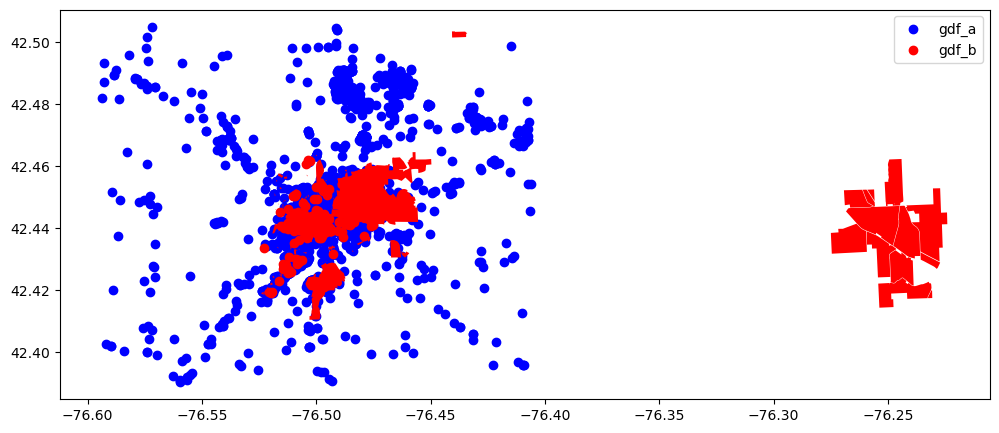

In [20]:

fig, ax = plt.subplots(figsize=(12, 8))

gdf_a.plot(ax=ax, color='blue', label='gdf_a')
gdf_b.plot(ax=ax, color='red', label='gdf_b')
ax.legend()
plt.show()

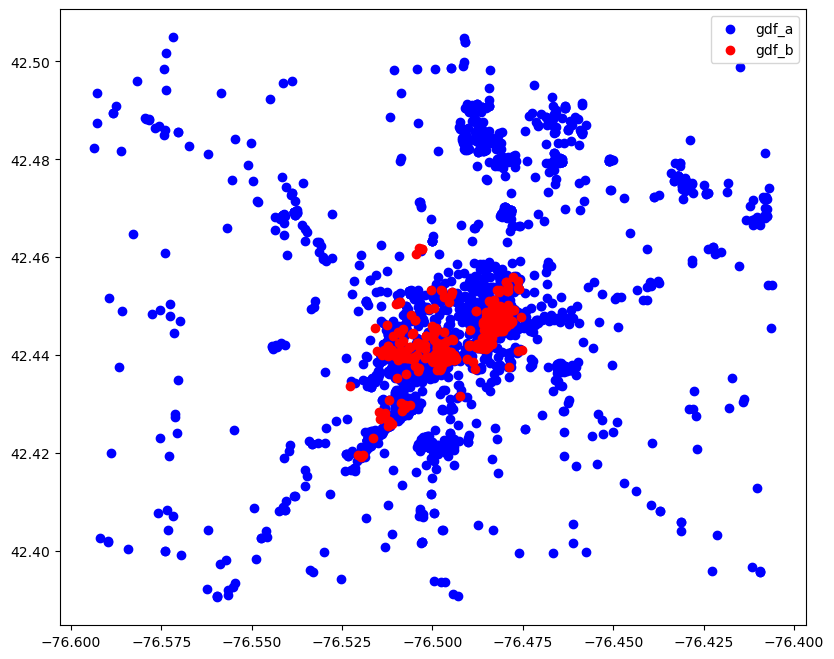

In [21]:

gdf_b = gdf_b[gdf_b['geometry'].type == 'Point']

fig, ax = plt.subplots(figsize=(12, 8))
gdf_a.plot(ax=ax, color='blue', label='gdf_a')
gdf_b.plot(ax=ax, color='red', label='gdf_b')
ax.legend()
plt.show()

In [44]:

# Merge the rows from gdf_b to gdf_a where names_primary and name match, keeping all columns from gdf_b
merged_gdf = gdf_a.merge(gdf_b, how='left', left_on='names_primary', right_on='name', suffixes=('', '_b'))

# Find the rows in gdf_b that do not have a match
unmatched_rows = gdf_b[~gdf_b['name'].isin(merged_gdf['names_primary'])]

# Set the 'dataset' column of unmatched rows to 'osm'
unmatched_rows['property dataset'] = 'osm'

# Append the unmatched rows to the merged dataset, keeping NaN in gdf_a columns for these rows
merged_gdf = pd.concat([merged_gdf, unmatched_rows], ignore_index=True)

# Display the merged data
print(merged_gdf)


                                               geometry  \
0                            POINT (-76.59182 42.40276)   
1                            POINT (-76.58966 42.40192)   
2                            POINT (-76.58962 42.40211)   
3                            POINT (-76.58416 42.40046)   
4                            POINT (-76.55952 42.39060)   
...                                                 ...   
3632  POLYGON ((-76.51328 42.43060, -76.51328 42.430...   
3633  POLYGON ((-76.51255 42.43006, -76.51325 42.430...   
3634  POLYGON ((-76.51264 42.42858, -76.51264 42.428...   
3635  POLYGON ((-76.51269 42.42946, -76.51269 42.429...   
3636  MULTIPOLYGON (((-76.52326 42.41922, -76.52313 ...   

                                    id  version               update_time  \
0     08f2aa4a99b0c3b30388a46bfd8bf453      0.0  2024-04-11T00:00:00.000Z   
1     08f2aa4a99b08b3203b838b86c286b0d      0.0  2024-04-11T00:00:00.000Z   
2     08f2aa4a99b0dc1a033ab72d2874efaf      0.0  2024-04-11T

C:\Users\86158\AppData\Roaming\Python\Python39\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
C:\Users\86158\AppData\Roaming\Python\Python39\site-packages\geopandas\array.py:1459: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 (the single non-null crs provided).
  return GeometryArray(data, crs=_get_common_crs(to_concat))


In [57]:
# Assuming 'merged_places' is your DataFrame containing the data
print(merged_places.columns)


Index(['geometry', 'id', 'version', 'update_time', 'names', 'categories',
       'confidence_overture', 'socials', 'addresses', 'websites',
       ...
       'lit', 'building:part', 'heating', 'area', 'fast_food', 'location',
       'grades', 'ways', 'type', 'note'],
      dtype='object', length=206)


In [55]:
merged_places.rename(columns={'property dataset': 'sources'}, inplace=True)

<Axes: >

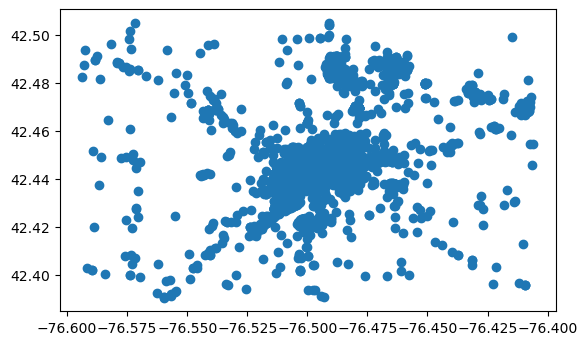

In [50]:
merged_places.plot()

In [53]:
import folium
from shapely.geometry import Point

# Initialize the map:
m = folium.Map(location=[42.45091, -76.49550], zoom_start=13)  # Centered based on your data's approximate coordinates

# Define colors for different sources
source_colors = {
    'osm': 'blue',
    'msft': 'green',
    'default': 'gray'   # For any other types not listed above
}

# Function to choose colors
def get_color(source):
    return source_colors.get(source, source_colors['default'])

# Add markers to the map
for index, row in merged_places.iterrows():
    # Extract coordinates
    if isinstance(row['geometry'], Point):
        lat = row['geometry'].y
        lon = row['geometry'].x

        # Safeguard against the missing 'sources' field
        source = row.get('sources', 'default')

        # Create marker
        folium.Marker(
            [lat, lon],
            popup=f"{row['names']['primary']}: {row.get('addresses', [{'freeform': 'No Address'}])[0]['freeform']}",
            icon=folium.Icon(color=get_color(source))
        ).add_to(m)  # Add this line to add the marker to the map

# Show the map
m


## Merging OSM and Tigerline Road Data

In [103]:
# Create two empty GeoDataFrames to store geometries of type 'Point' and 'Polygon'
points_gdf = roads[roads['geometry'].type.isin(['Point'])].copy()
polygons_gdf = roads[roads['geometry'].type.isin(['Polygon'])].copy()

# Remove records of type 'Point' and 'Polygon' from the original GeoDataFrame
roads = roads[~roads['geometry'].type.isin(['Point', 'Polygon'])]

In [115]:
gdf_a = roads
gdf_b = ithaca_tiger

In [122]:
gdf_a

crossing      highway  \
element_type osmid                              
way          20181025        NaN  residential   
             20181084        NaN  residential   
             20181090        NaN  residential   
             20181119        NaN      service   
             20181137        NaN  residential   
...                          ...          ...   
             1252512920      NaN      footway   
             1252512921      NaN      footway   
             1252512922      NaN      footway   
             1252512923      NaN      footway   
             1271200421      NaN      primary   

                                                                  geometry  \
element_type osmid                                                           
way          20181025    LINESTRING (-8518008.694 5228444.437, -8518004...   
             20181084    LINESTRING (-8515998.041 5228017.804, -8516077...   
             20181090    LINESTRING (-8515398.397 5225820.571, -8515397...   
             20181119    LINESTRING (-8513317.713 5227298.259, -8513317...   
             20181137    LINESTRING (-8516325.443 5225713.503, -8516328...   
...                                                                    ...   
             1252512920  LINESTRING (-8514542.205 5227517.696, -8514550...   
             1252512921  LINESTRING (-8515327.620 5227548.816, -8515322...   
             1252512922  LINESTRING (-8514175.285 5227634.665, -8514177...   
             1252512923  LINESTRING (-8513749.510 5227529.070, -8513767...   
             1271200421  LINESTRING (-8518135.153 5229811.814, -8518152...   

                        stop access barrier source direction crossing:island  \
element_type osmid                                                             
way          20181025    NaN    NaN     NaN    NaN       NaN             NaN   
             20181084    NaN    NaN     NaN    NaN       NaN             NaN   
             20181090    NaN    NaN     NaN    NaN       NaN             NaN   
             20181119    NaN    NaN     NaN    NaN       NaN             NaN   
             20181137    NaN    NaN     NaN    NaN       NaN             NaN   
...                      ...    ...     ...    ...       ...             ...   
             1252512920  NaN    NaN     NaN    NaN       NaN             NaN   
             1252512921  NaN    NaN     NaN    NaN       NaN             NaN   
             1252512922  NaN    NaN     NaN    NaN       NaN             NaN   
             1252512923  NaN    NaN     NaN    NaN       NaN             NaN   
             1271200421  NaN    NaN     NaN    NaN       NaN             NaN   

                        crossing:signals  ... cycleway:left:lane area  \
element_type osmid                        ...                           
way          20181025                NaN  ...                NaN  NaN   
             20181084                NaN  ...                NaN  NaN   
             20181090                NaN  ...                NaN  NaN   
             20181119                NaN  ...                NaN  NaN   
             20181137                NaN  ...                NaN  NaN   
...                                  ...  ...                ...  ...   
             1252512920              NaN  ...                NaN  NaN   
             1252512921              NaN  ...                NaN  NaN   
             1252512922              NaN  ...                NaN  NaN   
             1252512923              NaN  ...                NaN  NaN   
             1271200421              NaN  ...                NaN  NaN   

                        wikidata wikipedia informal tracktype ramp:wheelchair  \
element_type osmid                                                              
way          20181025        NaN       NaN      NaN       NaN             NaN   
             20181084        NaN       NaN      NaN       NaN             NaN   
             20181090        NaN       NaN      NaN     

In [116]:
gdf_b 

,LINEARID,FULLNAME,RTTYP,MTFCC,geometry
920,1104697442958,Co Rd 119,C,S1400,"LINESTRING (-8514968.709 5225485.397, -8514995..."
1308,1104697443664,Coddington Rd,M,S1400,"LINESTRING (-8514968.709 5225485.397, -8514995..."
1667,110763942392,State Rte 96B,S,S1200,"LINESTRING (-8515540.502 5225753.323, -8515536..."
111,1103690227442,S Hill Recreation Way,M,S1400,"LINESTRING (-8514967.681 5225491.842, -8514964..."
2821,110763963163,None,None,S1400,"LINESTRING (-8513663.955 5225799.584, -8513667..."
...,...,...,...,...,...
374,110763946613,Trumansburg Rd,M,S1200,"LINESTRING (-8518335.218 5229306.606, -8518379..."
373,1106087299824,Taughannock Blvd,M,S1200,"LINESTRING (-8518215.754 5229929.081, -8518210..."
717,110763963356,None,None,S1400,"LINESTRING (-8517604.961 5229569.741, -8517577..."
700,110763963756,None,None,S1740,"LINESTRING (-8517363.621 5229921.905, -8517337..."


In [118]:
print(gdf_a.crs)
print(gdf_b.crs)

EPSG:3857
EPSG:3857


<Axes: >

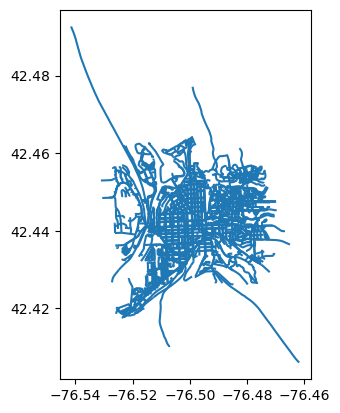

In [110]:
gdf_a.plot()

<Axes: >

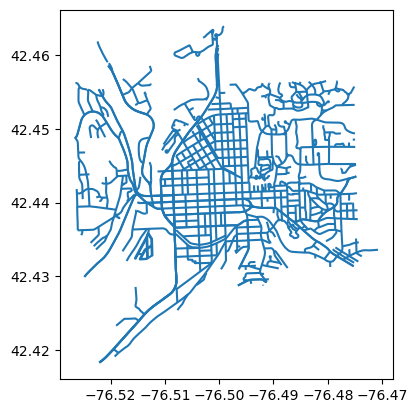

In [101]:
gdf_b.plot()

In [119]:
# Create a spatial index to reduce iterations and improve performance
spatial_index_b = gdf_b.sindex

# Set the threshold value m
threshold_m = 100

# Iterate over each line segment in a
# Iterate over each line segment in a
for index_a, row_a in gdf_a.iterrows():
    line_a = row_a['geometry']


    # Initialize the minimum distance and the nearest line segment in b
    min_distance = float('inf')
    nearest_b = None

    # Iterate over possible matches
    for index_b, row_b in possible_matches.iterrows():
        line_b = row_b['geometry']

        # Calculate the distance between line segments
        distance = line_a.distance(line_b)

        # Update the minimum distance and the nearest line segment in b
        if distance < min_distance:
            min_distance = distance
            nearest_b = row_b

    # If the minimum distance is less than the threshold value m, assign all attribute values from b to a
    if min_distance < threshold_m:
        gdf_a.loc[index_a, gdf_b.columns] = nearest_b[gdf_b.columns]
        
    else:
        # Check if the geometry from gdf_b is already in gdf_a to avoid duplicates
        if not gdf_a[gdf_a['geometry'] == line_b].empty:
            continue  # Skip adding a new row if the geometry already exists

        # If the minimum distance is greater than the threshold value, add new row to gdf_a
        new_row = row_b.copy()  # Copy the current row
        new_row['geometry'] = line_b  # Assign the geometry from gdf_a

        # Convert the new row to a DataFrame
        new_row_df = pd.DataFrame([new_row])

        # Concatenate gdf_a with the new row DataFrame
        merged_roads = pd.concat([gdf_a, new_row_df], ignore_index=True)

 

In [120]:
merged_roads

,crossing,highway,geometry,stop,access,barrier,source,direction,crossing:island,crossing:signals,...,informal,tracktype,ramp:wheelchair,unsigned_ref,ways,type,LINEARID,FULLNAME,RTTYP,MTFCC
0,NaN,residential,"LINESTRING (-8518008.694 5228444.437, -8518004...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,residential,"LINESTRING (-8515998.041 5228017.804, -8516077...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,residential,"LINESTRING (-8515398.397 5225820.571, -8515397...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,service,"LINESTRING (-8513317.713 5227298.259, -8513317...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,residential,"LINESTRING (-8516325.443 5225713.503, -8516328...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4739,NaN,footway,"LINESTRING (-8515327.620 5227548.816, -8515322...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4740,NaN,footway,"LINESTRING (-8514175.285 5227634.665, -8514177...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4741,NaN,footway,"LINESTRING (-8513749.510 5227529.070, -8513767...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4742,NaN,primary,"LINESTRING (-8518135.153 5229811.814, -8518152...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<Axes: >

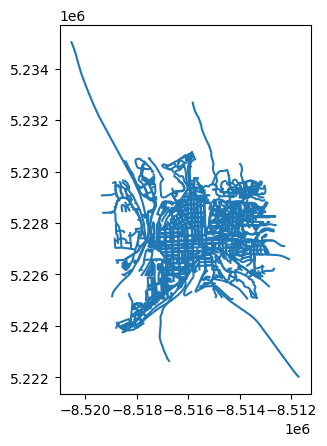

In [121]:
merged_roads.plot()